# Project Phase 1 - CSE 515

## Import required libraries and dataset

In [1]:
import os
import cv2
import numpy as np
import torch
import torchvision.transforms as transforms
from scipy.stats import moment
from PIL import Image
import warnings
warnings.filterwarnings("ignore")
from scipy.spatial.distance import cosine
from tqdm.notebook import tqdm
from scipy.stats import skew
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from sklearn.metrics.pairwise import cosine_similarity
from torchvision.models import resnet50
from torchvision.datasets import Caltech101
import pandas as pd
from ipywidgets import interact, widgets
from IPython.display import display, Markdown, HTML
from IPython.display import clear_output

In [2]:
#import the caltech101 dataset
caltech101 = Caltech101("~/CSE 515 - Multimedia Web Databases/",download=True)

Files already downloaded and verified


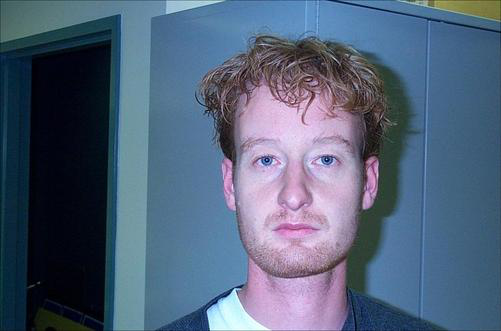

In [3]:
caltech101.__getitem__(index = 239)[0]  #example item

In [4]:
#initialise mean and std
mean_vals = [0, 0, 0]
std_dev_vals = [0, 0, 0]

In [5]:
for ids in range(len(caltech101)):
    image = caltech101.__getitem__(index=ids)[0]
    image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    image = image / 255.0  # Normalize pixel values to [0, 1]

    # Calculate mean and standard deviation for each channel
    for i in range(3):
        mean_vals[i] += np.mean(image[:,:,i])
        std_dev_vals[i] += np.std(image[:,:,i])

# Calculate final mean and standard deviation values
num_images = len(caltech101)
mean_vals = [val / num_images for val in mean_vals]
std_dev_vals = [val / num_images for val in std_dev_vals]

print(f'Mean Values: {mean_vals}')
print(f'Standard Deviation Values: {std_dev_vals}')

Mean Values: [0.5021372281891864, 0.5287581550675707, 0.5458470856851454]
Standard Deviation Values: [0.24773670511666424, 0.24607509728422117, 0.24912913964278197]


## Feature Extraction Functionality

### Color Moments 

In [6]:
def compute_cm(image):
    
    if image.shape[2] == 2:
        # 2 channeled images are converted into 3 channeled images (RGB)
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
    
    # Resize image to 300x100
    res_image = cv2.resize(image, (300, 100))
    
    # Partition image into 10x10 grid
    rows = np.vsplit(res_image, 10)
    cells = [np.hsplit(row, 10) for row in rows]
    cells = np.array(cells).reshape(-1, 100, 3)

    # Feature descriptor array is initialised to 0
    feature_descriptor = np.zeros((10, 10, 3, 3))

    # Compute color moments for each cell
    for i in range(10):
        for j in range(10):
            for k in range(3):
                channel = cells[i*10 + j][:, k]
                mean = np.mean(channel)
                std_dev = np.std(channel)
                skewness = skew(channel)
                feature_descriptor[i, j, k] = [mean, std_dev, skewness]

    return feature_descriptor

In [7]:
def plot_cm(feature_descriptor):
    
    # Display a total of 100 subplots
    fig, axs = plt.subplots(10, 10, figsize=(30, 30))
    plt.subplots_adjust(wspace=0.5, hspace=0.5)
    
    handles = [Line2D([0], [0], color='w', label='Mean', markerfacecolor='red', markersize=1),
                      Line2D([0], [0], color='w', label='Standard Deviation', markerfacecolor='green', markersize=1),
                      Line2D([0], [0], color='w', label='Skewness', markerfacecolor='blue', markersize=1)]

    for i in range(10):
        for j in range(10):
            moments = feature_descriptor[i, j]
            ax = axs[i, j]

            positions = np.array([1, 2, 3])  

            # Group 1: Mean (Red, Green, Blue)
            ax.bar(positions, moments[:, 0], width=1, color=['red', 'green', 'blue'], alpha=0.5, label='M')

            # Group 2: Std Deviation (Red, Green, Blue)
            ax.bar(positions + 4, moments[:, 1], width=1, color=['red', 'green', 'blue'], alpha=0.5, label='St')

            # Group 3: Skewness (Red, Green, Blue)
            ax.bar(positions + 8, moments[:, 2], width=1, color=['red', 'green', 'blue'], alpha=0.5, label='Sk')

            ax.set_xticks([2, 6, 10])
            ax.set_xticklabels(['M', 'St', 'Sk'])
            ax.set_title(f'Cell ({i+1}, {j+1})')

    # Add legend at top right
    axs[0, -1].legend(handles=handles, loc='upper right', bbox_to_anchor=(1.1, 1.5), frameon=False)

    plt.show()

In [8]:
index = 1300
image = cv2.cvtColor(np.array(caltech101.__getitem__(index = index)[0]),cv2.COLOR_RGB2BGR)

In [9]:
image.shape

(172, 264, 3)

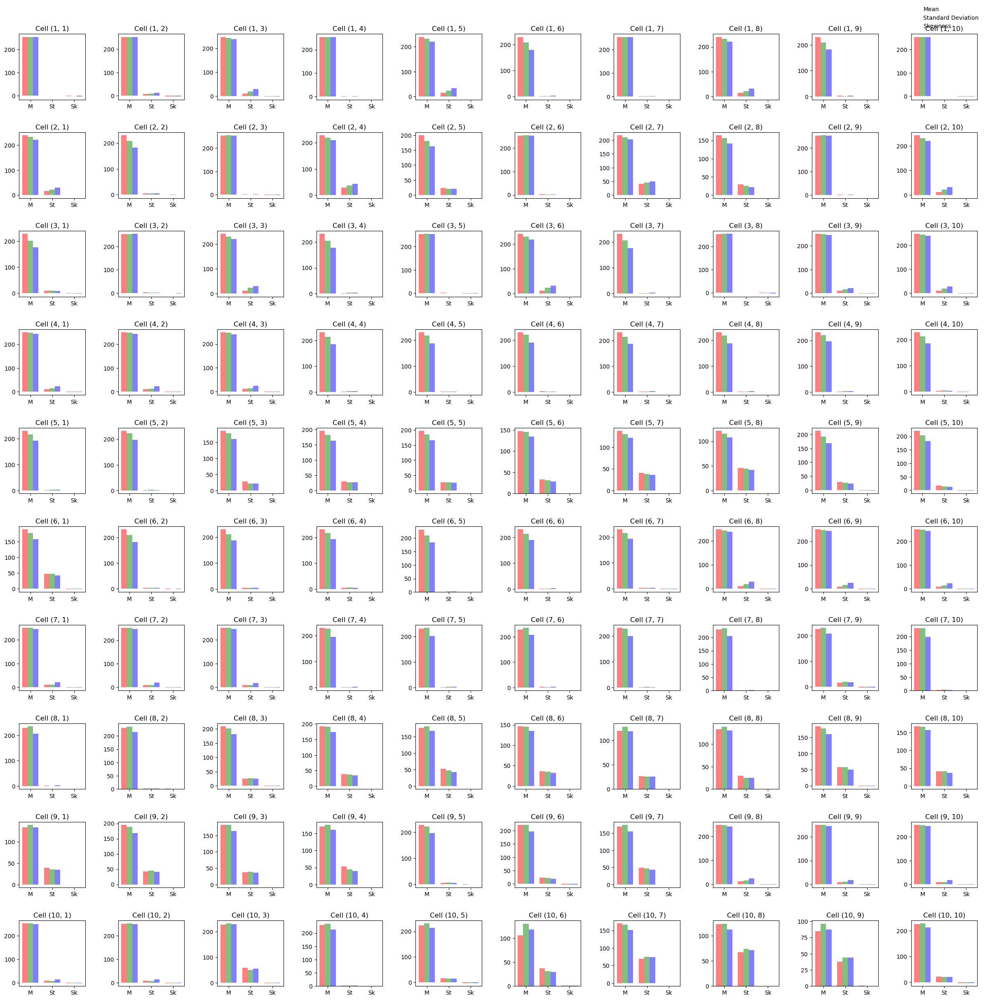

In [10]:
cm = compute_cm(image)
plot_cm(cm)

### Histograms of Oriented Gradients (HOG)  

In [11]:
def compute_HOG(image):
    # Convert image to grayscale
    gry_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Resize image to 300x100
    res_image = cv2.resize(gry_img, (300, 100))

    # Define the cell size
    cell_size = (30, 10)

    # Empty HOG descriptor array
    hog_des = []

    # Compute HOG descriptor for each cell
    for i in range(10):
        for j in range(10):
            # Extract cell
            c = res_image[i*cell_size[1]:(i+1)*cell_size[1], j*cell_size[0]:(j+1)*cell_size[0]]

            # Gradients with sobel filter for extracted cell
            grad_x = cv2.Sobel(c, cv2.CV_64F, 1, 0, ksize=5)
            grad_y = cv2.Sobel(c, cv2.CV_64F, 0, 1, ksize=5)

            # Compute gradient magnitude and orientation
            mag, ang = cv2.cartToPolar(grad_x, grad_y, angleInDegrees=True)

            # Histogram for cell
            hist, _ = np.histogram(ang, bins=9, range=(0, 180), weights=mag)

            # Append the histogram values to the HOG descriptor
            hog_des.extend(hist)

    return np.array(hog_des)

In [12]:
hog_vals = compute_HOG(image)

In [13]:
hog_vals.shape

(900,)

In [14]:
def vis_hog(hog_des, cell_size=(30, 10)):
    # Create a canvas
    cvs = np.zeros((100, 300), dtype=np.uint8)

    for i in range(10):
        for j in range(10):
            # Center of the cell
            cen = (j*cell_size[0] + cell_size[0]//2, i*cell_size[1] + cell_size[1]//2)

            # Compute the endpoint of the gradient vector based on the HOG descriptor
            ang = (hog_des[i*10 + j] * 20) - 90
            length = min(cell_size) // 2
            end_pt = (int(cen[0] + length * np.cos(np.radians(ang))),
                        int(cen[1] + length * np.sin(np.radians(ang))))

            # Draw a line on the canvas
            cv2.line(cvs, cen, end_pt, 255, 1)

    # Visualisation
    plt.imshow(cvs, cmap='Blues')
    plt.axis('off')
    plt.show()

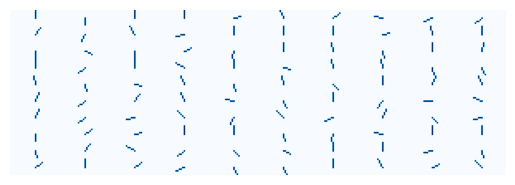

In [15]:
vis_hog(hog_vals)

### ResNet-AvgPool-1024 

In [16]:
model = resnet50(pretrained=True)

In [17]:
def compute_avgpool(image):
    
    # Initialise a hook to get the output of the 'avgpool' layer
    hook = None
    def hook_fn(module, input, output):
        nonlocal hook
        hook = output

    # Attach the hook to the "avgpool" layer
    model.avgpool.register_forward_hook(hook_fn)

    # Preprocess the image
    def pp_image(image):
        transform = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_vals, std=std_dev_vals),
        ])
        return transform(image).unsqueeze(0)

    # Fnuction to get the 2048 dimensional vector
    def get_2048_dim_vector(image):
        input_tr = pp_image(image)
        model.eval()
        with torch.no_grad():
            _ = model(input_tr)
        return hook.squeeze().numpy()

    # Get the 2048-dimensional vector
    vector_2048 = get_2048_dim_vector(image)

    # Reduce dimensions to 1024 by averaging adjacent entries
    vector_1024 = [(v1 + v2) / 2 for v1, v2 in zip(vector_2048[::2], vector_2048[1::2])]

    return vector_1024

In [18]:
def vis_vector(vector):
    plt.figure(figsize=(10,5))
    plt.bar(range(len(vector)), vector)
    plt.title('Vector Visualization')
    plt.xlabel('Dimension')
    plt.ylabel('Value')
    plt.show()

In [19]:
avgpool_fd = compute_avgpool(image)

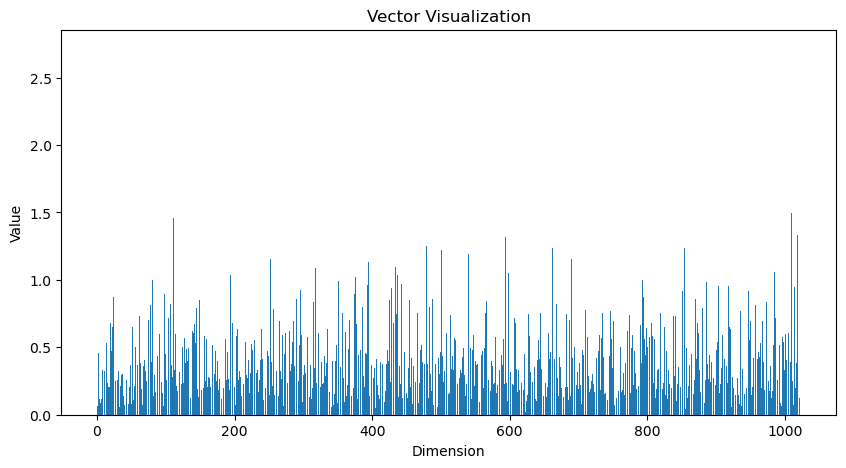

In [20]:
vis_vector(avgpool_fd)

### ResNet-Layer3-1024 

In [21]:
def compute_layer3(image):
    
    # Initialise a hook to get the output of the 'layer3' layer
    hook = None
    def hook_fn(module, input, output):
        nonlocal hook
        hook = output

    # Attach the hook to the "layer3" layer
    model.layer3.register_forward_hook(hook_fn)

    # Define a function to preprocess the image
    def pp_image(image):
        transform = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_vals, std=std_dev_vals),
        ])
        return transform(image).unsqueeze(0)

    # Function to get the 1024x14x14 tensor
    def get_1024x14x14_tensor(image):
        input_tr = pp_image(image)
        model.eval()
        with torch.no_grad():
            _ = model(input_tr)
        return hook.squeeze()

    # Get the 1024x14x14 tensor
    tensor_1024x14x14 = get_1024x14x14_tensor(image)

    # Convert the tensor to a 1024-dimensional vector by averaging each 14x14 slice
    vector_1024 = torch.mean(tensor_1024x14x14.view(1024, -1), dim=1).numpy()

    return vector_1024

In [22]:
layer3_fd = compute_layer3(image)

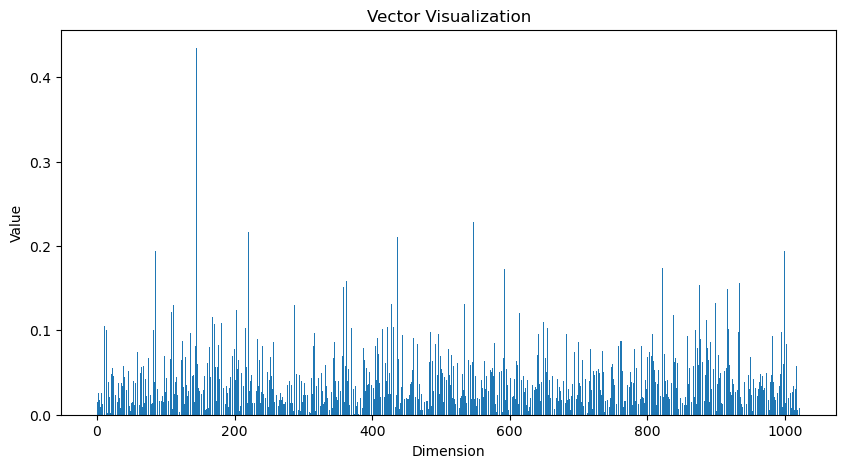

In [23]:
vis_vector(layer3_fd)

###  ResNet-FC-1000

In [24]:
def compute_fc(image):
    
    # Initialise a hook to get the output of the "fc" layer
    hook = None
    def hook_fn(module, input, output):
        nonlocal hook
        hook = output

    # Attach the hook to the "fc" layer
    model.fc.register_forward_hook(hook_fn)

    # Define a function to preprocess the image
    def pp_image(image):
        transform = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_vals, std=std_dev_vals),
        ])
        return transform(image).unsqueeze(0)

    # Define a function to get the 1000-dimensional tensor
    def get_1000_dimensional_tensor(image):
        input_tr = pp_image(image)
        model.eval()
        with torch.no_grad():
            _ = model(input_tr)
        return hook.squeeze()

    # Get the 1000-dimensional tensor
    tensor_1000 = get_1000_dimensional_tensor(image)

    return tensor_1000

In [25]:
fc_fd = compute_fc(image)

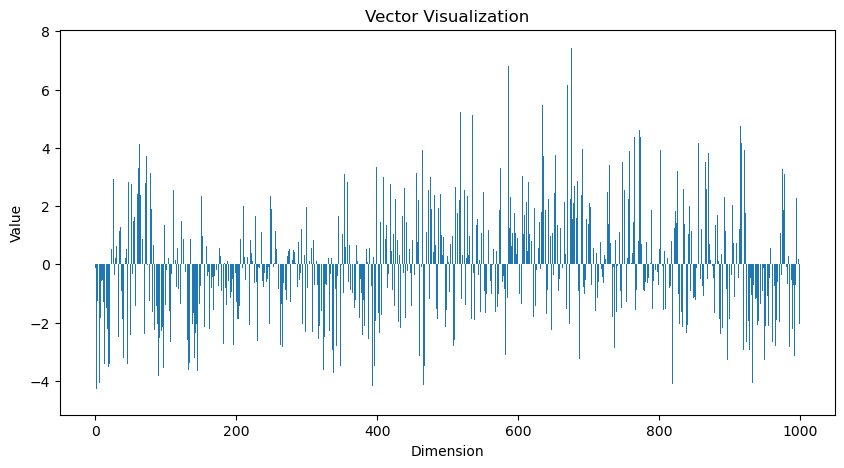

In [26]:
vis_vector(fc_fd)

## Similarity Scores 

### Euclidean Distance for Color Moments 

In [27]:
#function to normalize the feature vecor to have unit length
def normalize_vector(vector):
    if np.isnan(vector).any():
        # Handle the presence of NaN values 
        vector = np.nan_to_num(vector)

    # L2 norm
    norm = np.linalg.norm(vector)
    return vector / norm if norm != 0 else vector

def euclidean_dist(x, y):
    return np.linalg.norm(x - y)

def compute_similarity_cm(moments1, moments2):
    # Normalize the feature vectors
    norm_moments1 = normalize_vector(moments1)
    norm_moments2 = normalize_vector(moments2)
    
    # Calculate the Euclidean Distance
    similarity = euclidean_dist(norm_moments1, norm_moments2)

    return round(similarity,5)

### Cosine Similarity for HOG

In [28]:
def cosine_similarity_sc(des1, des2, normalize=True):
    if normalize:
        des1 = normalize_vector(des1)
        des2 = normalize_vector(des2)
    
    # Reshape descriptors as needed
    des1 = np.reshape(des1, (1, -1))
    des2 = np.reshape(des2, (1, -1))

    similarity = cosine_similarity(des1, des2)
    return similarity[0][0]

In [29]:
def compute_similarity_hist(des1, des2):
    return round(cosine_similarity_sc([des1], [des2]),5)

### Cosine Similarity for Avgpool 

In [30]:
def compute_avgpool_similarity(des1, des2):
    # Calculate Cosine Similarity for avgpool descriptors
    return round(cosine_similarity_sc([des1], [des2]),5)

### Euclidean Distance for Layer3

In [31]:
def compute_layer3_similarity(des1, des2):
    # Calculate Euclidean distance between two layer3 descriptors
    norm_des1 = normalize_vector(des1)
    norm_des2 = normalize_vector(des2)

    # Calculate the Euclidean Distance
    similarity = euclidean_dist(norm_des1, norm_des2)

    return round(similarity,5)

### Cosine Similarity for FC

In [32]:
def compute_fc_similarity(des1, des2):
    # Convert to NumPy arrays if they are Tensors
    if isinstance(des1, torch.Tensor):
        des1 = des1.numpy()
    if isinstance(des2, torch.Tensor):
        des2 = des2.numpy()

    # Calculate Cosine Similarity for fc descriptors
    return round(cosine_similarity_sc([des1], [des2]), 5)

## Testing between images

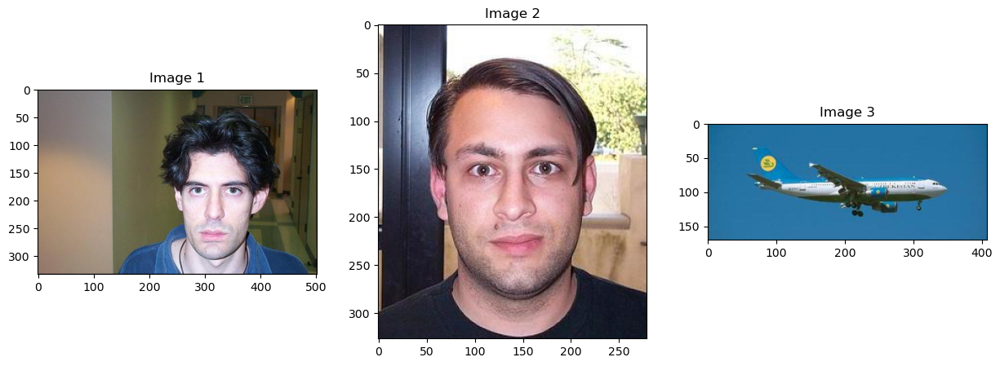

In [33]:
img_1 = cv2.cvtColor(np.array(caltech101.__getitem__(index=372)[0]), cv2.COLOR_RGB2BGR)
img_2 = cv2.cvtColor(np.array(caltech101.__getitem__(index=738)[0]), cv2.COLOR_RGB2BGR)
img_3 = cv2.cvtColor(np.array(caltech101.__getitem__(index=2600)[0]), cv2.COLOR_RGB2BGR)

#Figure with 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display Image 1
axes[0].imshow(cv2.cvtColor(img_1, cv2.COLOR_BGR2RGB))
axes[0].set_title('Image 1')

# Display Image 2
axes[1].imshow(cv2.cvtColor(img_2, cv2.COLOR_BGR2RGB))
axes[1].set_title('Image 2')

# Display Image 3
axes[2].imshow(cv2.cvtColor(img_3, cv2.COLOR_BGR2RGB))
axes[2].set_title('Image 3')

# Hide axis labels
# for ax in axes:
#     ax.axis('off')

# Show the plot
plt.show()

In [34]:
cm_1 = compute_cm(img_1)
cm_2 = compute_cm(img_2)
cm_3 = compute_cm(img_3)

In [35]:
hog_1= compute_HOG(img_1)
hog_2= compute_HOG(img_2)
hog_3= compute_HOG(img_3)

In [36]:
avgpool_1 = compute_avgpool(img_1)
avgpool_2 = compute_avgpool(img_2)
avgpool_3 = compute_avgpool(img_3)

In [37]:
layer3_1 = compute_layer3(img_1)
layer3_2 = compute_layer3(img_2)
layer3_3 = compute_layer3(img_3)

In [38]:
fc_1 = compute_fc(img_1)
fc_2 = compute_fc(img_2)
fc_3 = compute_fc(img_3)

In [39]:
print(compute_similarity_cm(cm_1,cm_2))
print(compute_similarity_cm(cm_2,cm_3))
print(compute_similarity_cm(cm_1,cm_3))

0.67734
0.62684
0.66283


In [40]:
print(compute_similarity_hist(hog_1,hog_2))
print(compute_similarity_hist(hog_2,hog_3))
print(compute_similarity_hist(hog_1,hog_3))

0.2144
0.26621
0.13845


In [41]:
print(compute_avgpool_similarity(avgpool_1,avgpool_2))
print(compute_avgpool_similarity(avgpool_2,avgpool_3))
print(compute_avgpool_similarity(avgpool_3,avgpool_1))

0.89987
0.62292
0.61421


In [42]:
print(compute_layer3_similarity(layer3_1,layer3_2))
print(compute_layer3_similarity(layer3_2,layer3_3))
print(compute_layer3_similarity(layer3_3,layer3_1))

0.4181
0.72314
0.63718


In [43]:
print(compute_fc_similarity(fc_1,fc_2))
print(compute_fc_similarity(fc_2,fc_3))
print(compute_fc_similarity(fc_3,fc_1))

0.82882
-0.00375
-0.14484


## MongoDB

In [44]:
import pymongo
from pymongo import MongoClient

#connecting mongodb to a localhost port
client = MongoClient('localhost',27017)
db = client['CSE515-MWD-Nikhil_V_Ramanan-ProjectPhase1']
collection = db['image_features']
collection

Collection(Database(MongoClient(host=['localhost:27017'], document_class=dict, tz_aware=False, connect=True), 'CSE515-MWD-Nikhil_V_Ramanan-ProjectPhase1'), 'image_features')

In [45]:
def compute_descriptors(image, ids):
    #computing color moments
    cm = compute_cm(image)
    hog = compute_HOG(image)
    avgpool = compute_avgpool(image)
    layer3 = compute_layer3(image)
    fc = compute_fc(image)
    
    return {
        '_id': ids,
        'image': image.tolist() if isinstance(image, np.ndarray) else image,  
        'color_moments': cm.tolist() if isinstance(cm, np.ndarray) else cm,
        'hog_descriptor': hog.tolist() if isinstance(hog, np.ndarray) else hog,
        'avgpool_descriptor': avgpool.tolist() if isinstance(avgpool, np.ndarray) else avgpool,
        'layer3_descriptor': layer3.tolist() if isinstance(layer3, np.ndarray) else layer3,
        'fc_descriptor': fc.tolist()
    }

In [46]:
def push_mongodb():
    for ids in tqdm(range(len(caltech101))):
        image = cv2.cvtColor(np.array(caltech101.__getitem__(index = ids)[0]),cv2.COLOR_RGB2BGR)
        descriptors = compute_descriptors(image, ids)
        collection.update_one({'_id':ids},{'$set':descriptors},upsert = True)

In [47]:
def push_des_to_mongodb(descriptors):
    ids = descriptors["_ids"]
    collection.update_one({'_id':ids},{'$set':descriptors},upsert = True)

In [49]:
push_to_mongodb()

  0%|          | 0/8677 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [49]:
document = collection.find_one({'_id': 4})

# Print the entire document
print(document)

{'_id': 4, 'avgpool_descriptor': [0.6053220629692078, 0.17748036980628967, 0.7688790559768677, 1.2463245391845703, 0.22362163662910461, 0.38802477717399597, 0.20469272136688232, 0.6654967665672302, 0.3878328800201416, 0.36415502429008484, 0.28175902366638184, 0.35240352153778076, 0.12664605677127838, 0.4577103853225708, 0.4990242123603821, 0.18823839724063873, 0.974524974822998, 0.3424829840660095, 0.5306918025016785, 0.42094045877456665, 0.30896252393722534, 0.4311506152153015, 0.3048739433288574, 0.9033830761909485, 0.5568626523017883, 0.21457092463970184, 0.6193149089813232, 0.3661998212337494, 0.027730707079172134, 0.3166359066963196, 0.12973105907440186, 0.5068970322608948, 0.6534987688064575, 0.4434244632720947, 0.05743813514709473, 0.3863506615161896, 0.11284533888101578, 0.3023246228694916, 0.5946168899536133, 0.0757233202457428, 0.3900585472583771, 0.1904086321592331, 1.1343388557434082, 0.23207497596740723, 0.611845850944519, 0.54555344581604, 0.2689984440803528, 0.3876014053

In [50]:
def to_base64(image):
    from io import BytesIO
    import base64

    image_pil = Image.fromarray(image)
    buffered = BytesIO()
    image_pil.save(buffered, format="PNG")
    return base64.b64encode(buffered.getvalue()).decode()

def show_image_centered(image):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_html = f"<img src='data:image/png;base64,{to_base64(image)}' style='display: block; margin-left: auto; margin-right: auto;'>"
    display(HTML(image_html))


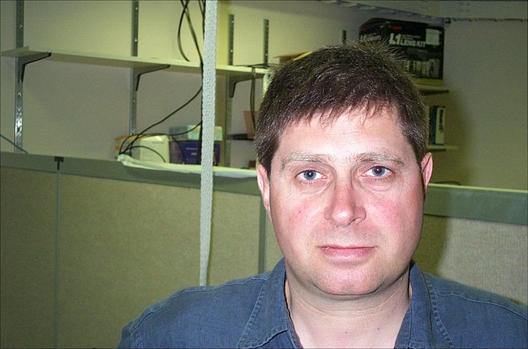

In [51]:
image = np.array(document['image'], dtype=np.uint8)
show_image_centered(image)

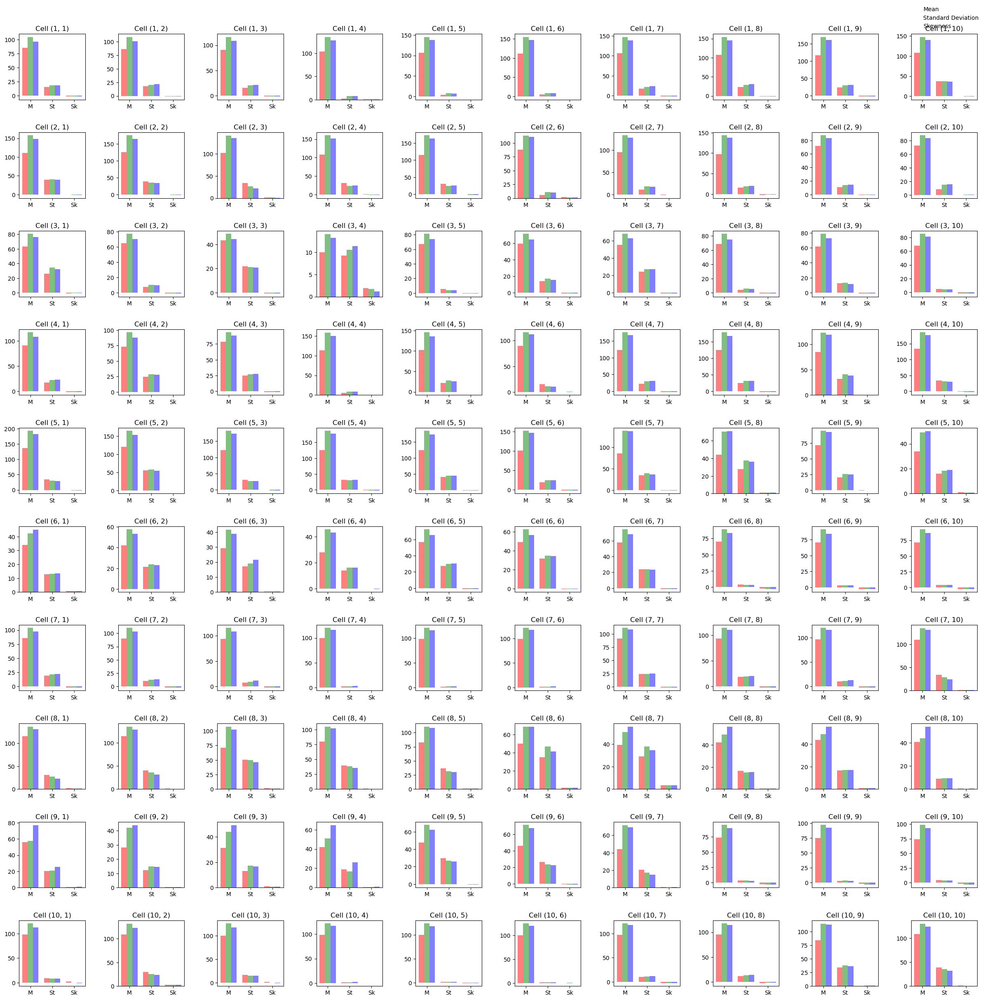

In [52]:
plot_cm(np.array(document['color_moments']))

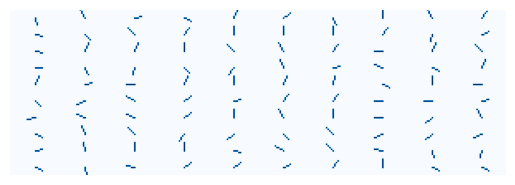

In [53]:
vis_hog(document['hog_descriptor'])

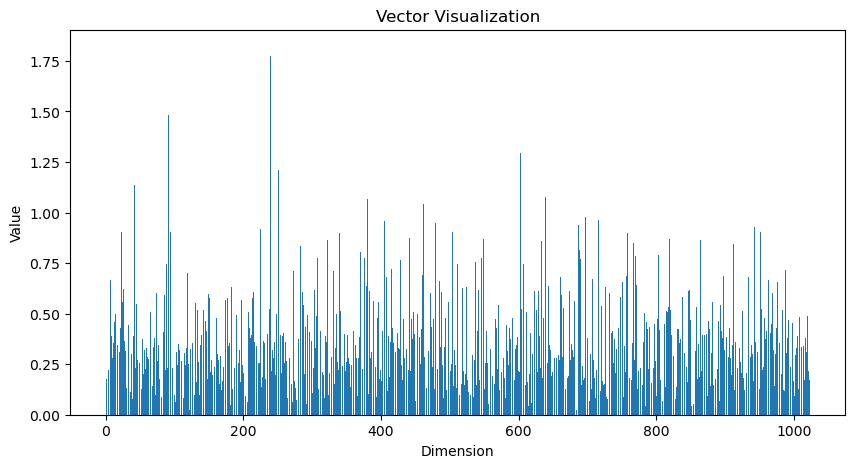

In [54]:
vis_vector(document['avgpool_descriptor'])

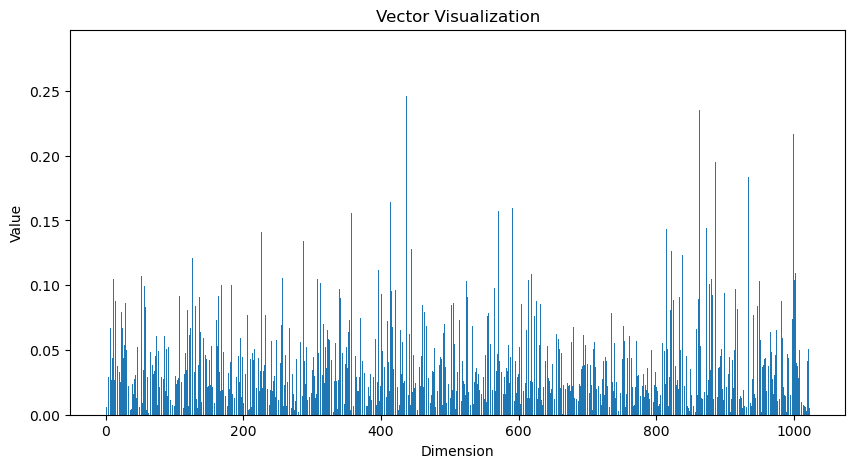

In [55]:
vis_vector(document['layer3_descriptor'])

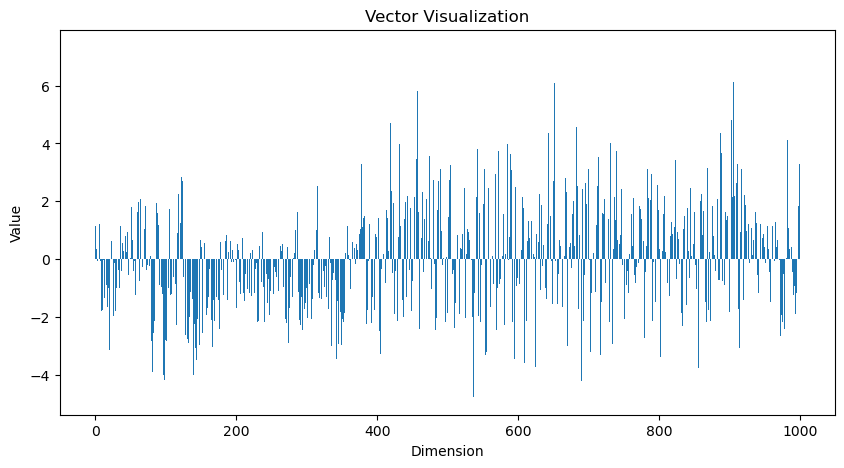

In [56]:
vis_vector(document['fc_descriptor'])

## Calculate similarity scores

In [57]:
def check_similarities(index):
    document1 = collection.find_one({'_id': index})
    similarities = {
        "color_moments": {},
        "hog_descriptor": {},
        "avgpool_descriptor": {},
        "layer3_descriptor": {},
        "fc_descriptor": {}
    }
    
    for cmpidx in tqdm(range(len(caltech101))):
        if cmpidx != index:
            document2 = collection.find_one({"_id": cmpidx})
            
            # Corrected the use of 'not' instead of '!'
            color_moments_similarity = compute_similarity_cm(document1["color_moments"], document2["color_moments"])
            histogram_similarity = compute_similarity_hist(document1["hog_descriptor"], document2["hog_descriptor"])
            avgpool_similarity = compute_avgpool_similarity(document1["avgpool_descriptor"], document2["avgpool_descriptor"])
            layer3_similarity = compute_layer3_similarity(document1["layer3_descriptor"], document2["layer3_descriptor"]) 
            fc_similarity = compute_fc_similarity(document1["fc_descriptor"], document2["fc_descriptor"])
            if not np.isnan(color_moments_similarity):
                similarities["color_moments"][cmpidx] = color_moments_similarity
            else: 
                similarities["color_moments"][cmpidx] = 1
            similarities["hog_descriptor"][cmpidx] =  histogram_similarity
            similarities["avgpool_descriptor"][cmpidx] =  avgpool_similarity
            similarities["layer3_descriptor"][cmpidx] = layer3_similarity
            similarities["fc_descriptor"][cmpidx] =  fc_similarity
    
    return similarities

In [58]:
#To check if the method generates expected output
similarity_scores = check_similarities(699)

  0%|          | 0/8677 [00:00<?, ?it/s]

In [59]:
def create_image_grid(images, indices, similarity_scores, rows, cols):
    k = len(images)

    # Create a grid of subplots
    fig, axes = plt.subplots(rows, cols, figsize=(12, 8))
    fig.subplots_adjust(wspace=0.3, hspace=0.5)

    for i, ax in enumerate(axes.flat):
        if i < k:
            ax.imshow(images[i], cmap='gray')  # Assuming grayscale images
            ax.axis('off')
            ax.set_title(f"Index: {indices[i]}", fontsize=10)
            ax.text(
                0.5, -0.15, f"Similarity Score: {similarity_scores[i]:.5f}",
                transform=ax.transAxes,
                fontsize=10,
                ha='center'
            )
        else:
            ax.axis('off')

    plt.show()

In [60]:
def display_ksimilar(k):
    images = []
    indices = []
    similarity_scores = []
    count = len(k.keys())
    rows = int(count/5)
    if (rows*5)<count: rows+=1
    cols = 5
    for index in k.keys():
        document = collection.find_one({'_id': index})
        images.append(cv2.cvtColor(np.array(document['image'], dtype=np.uint8), cv2.COLOR_BGR2RGB))
        indices.append(index)
        similarity_scores.append(k[index])
        
    create_image_grid(images, indices, similarity_scores, rows, cols)    

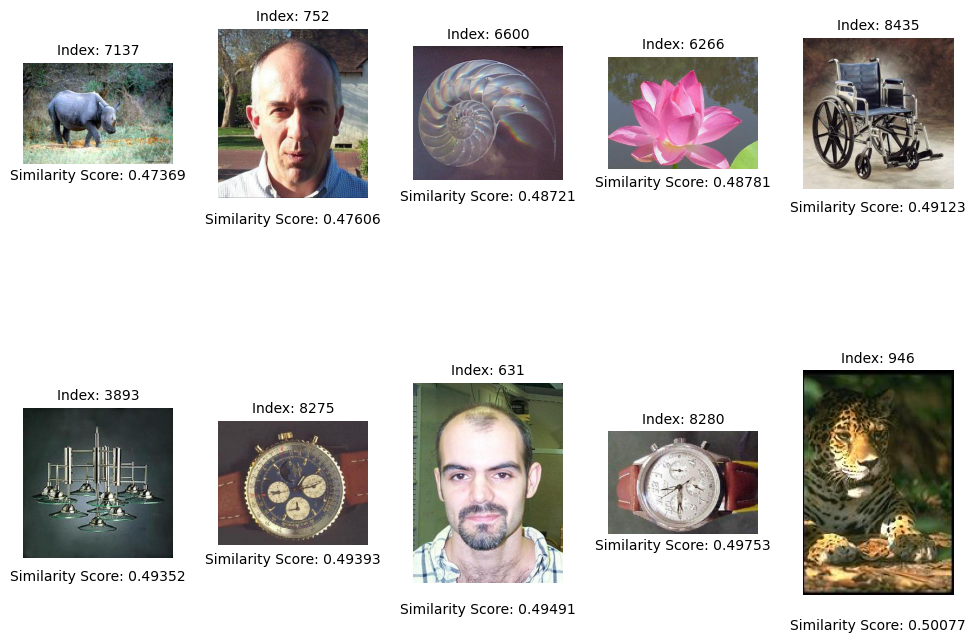

In [61]:
k = 10
similar_color_moments = dict(sorted(similarity_scores["color_moments"].items(), key = lambda x: x[1])[:k])

#Display to test color moments 
display_ksimilar(similar_color_moments)

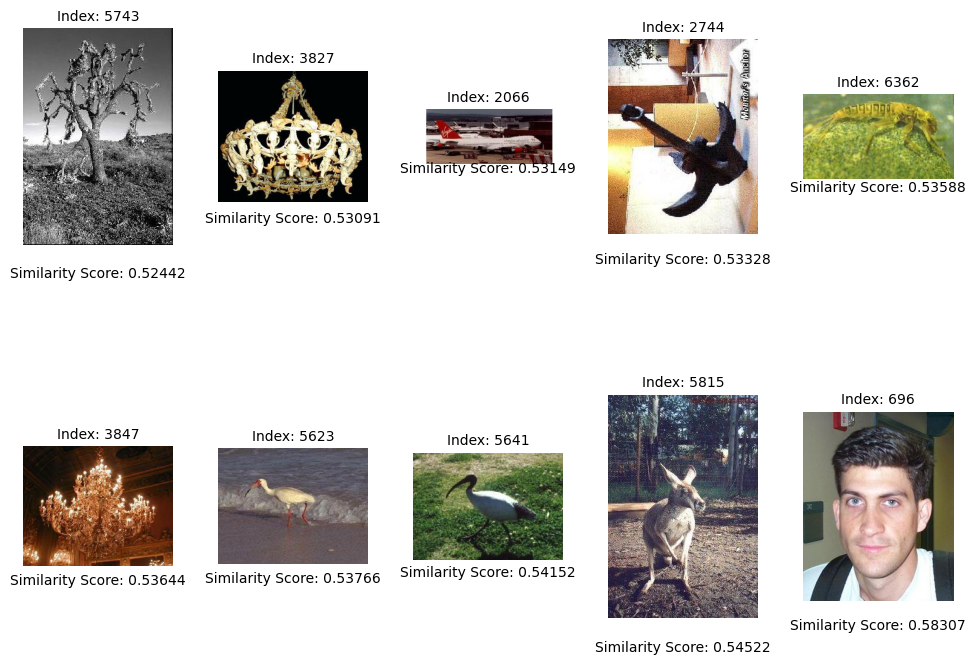

In [62]:
similar_hog = dict(sorted(similarity_scores["hog_descriptor"].items(), key = lambda x: x[1])[-k:])
#Display to test hog 
display_ksimilar(similar_hog)

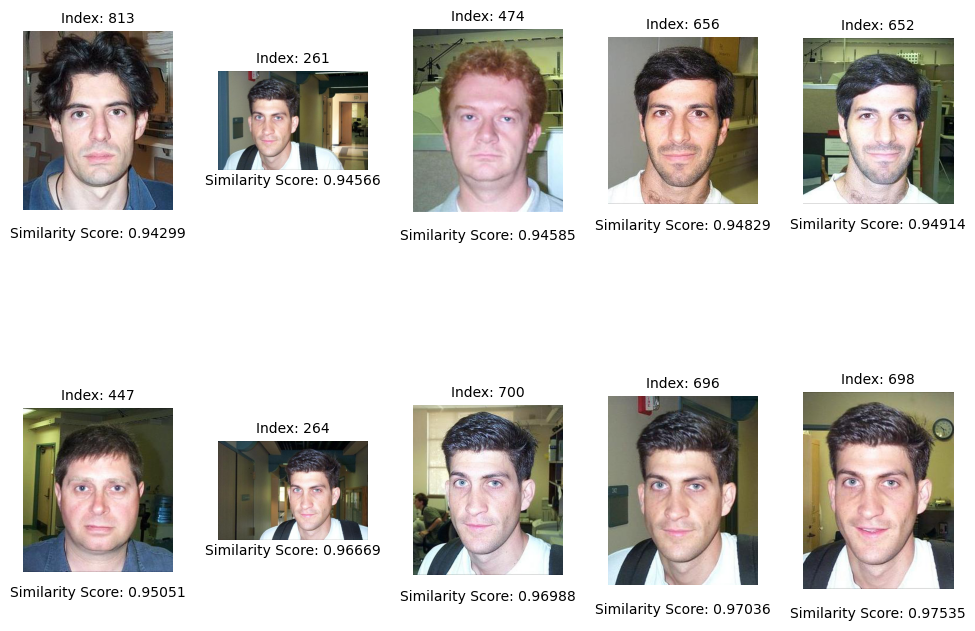

In [63]:
similar_avgpool = dict(sorted(similarity_scores["avgpool_descriptor"].items(), key = lambda x: x[1])[-k:])

#Display to test avgpool
display_ksimilar(similar_avgpool)

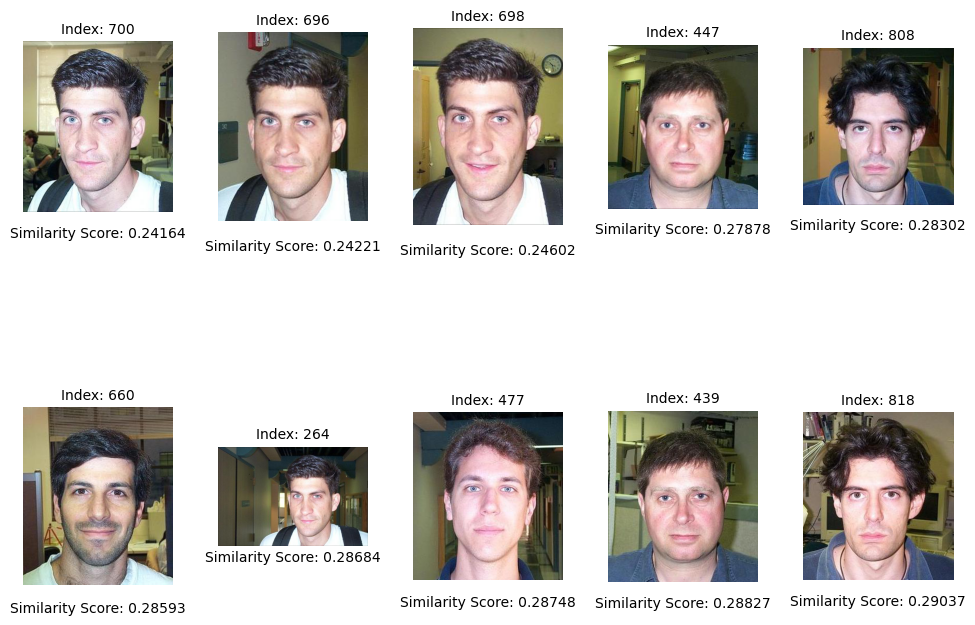

In [64]:
similar_layer3 = dict(sorted(similarity_scores["layer3_descriptor"].items(), key = lambda x: x[1])[:k])
display_ksimilar(similar_layer3)

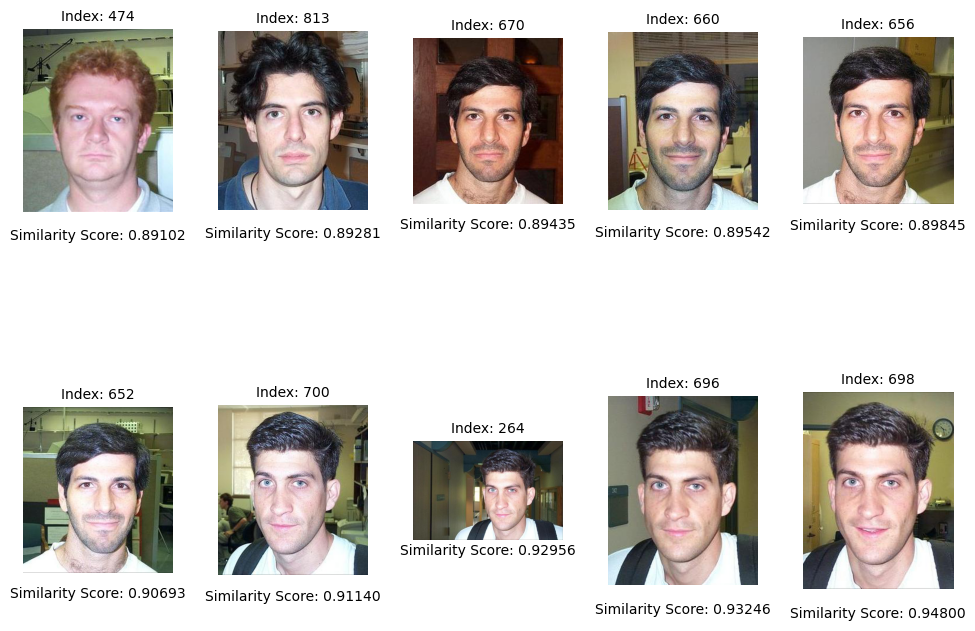

In [65]:
similar_fc = dict(sorted(similarity_scores["fc_descriptor"].items(), key = lambda x: x[1])[-k:])

#To test ResNet
display_ksimilar(similar_fc)

In [66]:
def task3(index,k):
    similarity_scores = check_similarities(index)
    similar_color_moments = dict(sorted(similarity_scores["color_moments"].items(), key = lambda x: x[1])[:k])
    similar_hog = dict(sorted(similarity_scores["hog_descriptor"].items(), key = lambda x: x[1])[-k:])
    similar_avgpool = dict(sorted(similarity_scores["avgpool_descriptor"].items(), key = lambda x: x[1])[-k:])
    similar_layer3 = dict(sorted(similarity_scores["layer3_descriptor"].items(), key = lambda x: x[1])[:k])
    similar_fc = dict(sorted(similarity_scores["fc_descriptor"].items(), key = lambda x: x[1])[-k:])
    document = collection.find_one({'_id': index})
    image = np.array(document['image'], dtype=np.uint8)
    display(Markdown("### Query Image"))
    show_image_centered(np.array(image))
    display(Markdown("### Query Image Color Moments"))
    plot_cm(np.array(document['color_moments']))
    display(Markdown("### Query Image HOG Descriptor"))
    vis_hog(document['hog_descriptor'])
    display(Markdown("### Query Image Avgpool Descriptor"))
    vis_vector(document['avgpool_descriptor'])
    display(Markdown("### Query Image Layer3 Descriptor"))
    vis_vector(document['layer3_descriptor'])
    display(Markdown("### Query Image FC Descriptor"))
    vis_vector(document['fc_descriptor'])
    display(Markdown('### Color Moments - Euclidean Distance'))
    display_ksimilar(similar_color_moments)
    display(Markdown('### Histograms of Oriented Gradients(HOG) - Cosine Similarity'))
    display_ksimilar(similar_hog)
    display(Markdown('### ResNet-AvgPool-1024 - Cosine Similarity'))
    display_ksimilar(similar_avgpool)
    display(Markdown('### ResNet-Layer3-1024 - Euclidean Distance'))
    display_ksimilar(similar_layer3)
    display(Markdown('### ResNet-FC-1000 - Cosine Similarity'))
    display_ksimilar(similar_fc)
    return similarity_scores

## Query Images Output

  0%|          | 0/8677 [00:00<?, ?it/s]

### Query Image


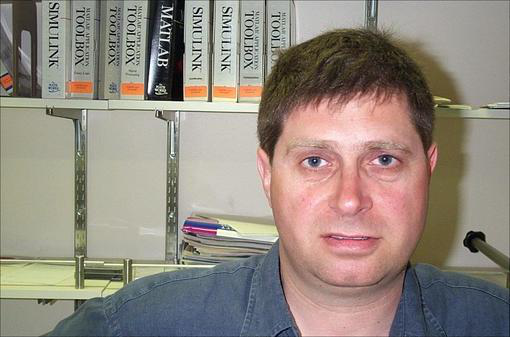

### Query Image Color Moments

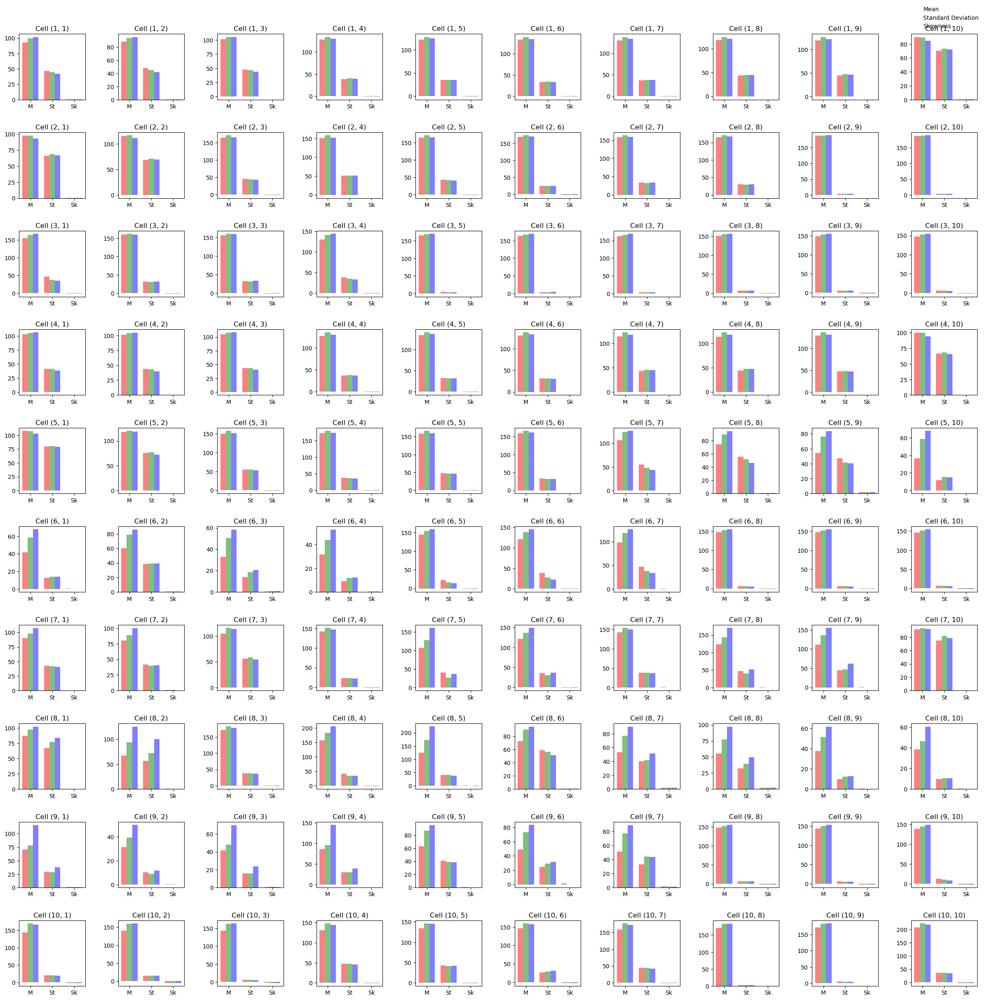

### Query Image HOG Descriptor

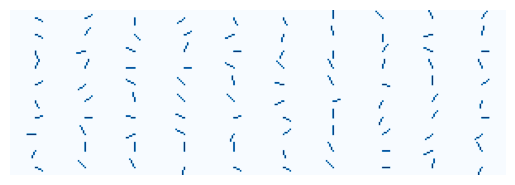

### Query Image Avgpool Descriptor

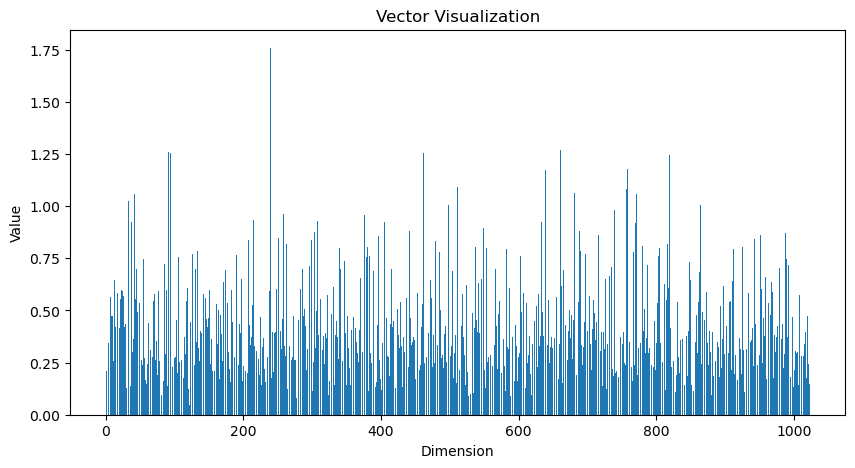

### Query Image Layer3 Descriptor

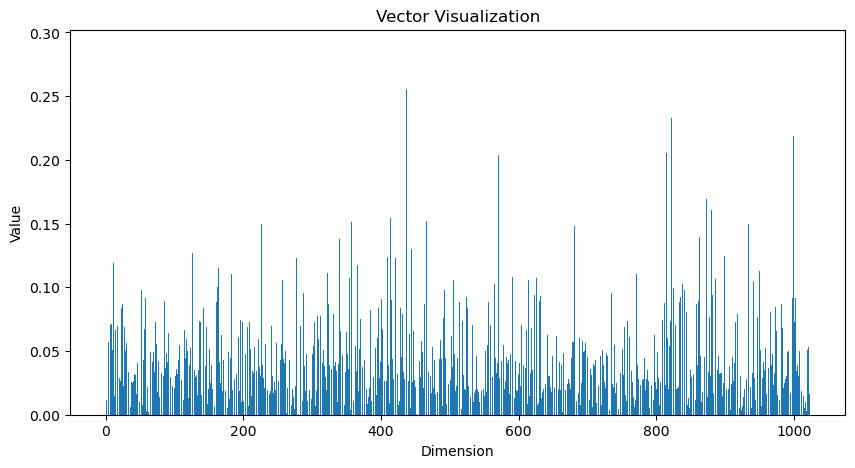

### Query Image FC Descriptor

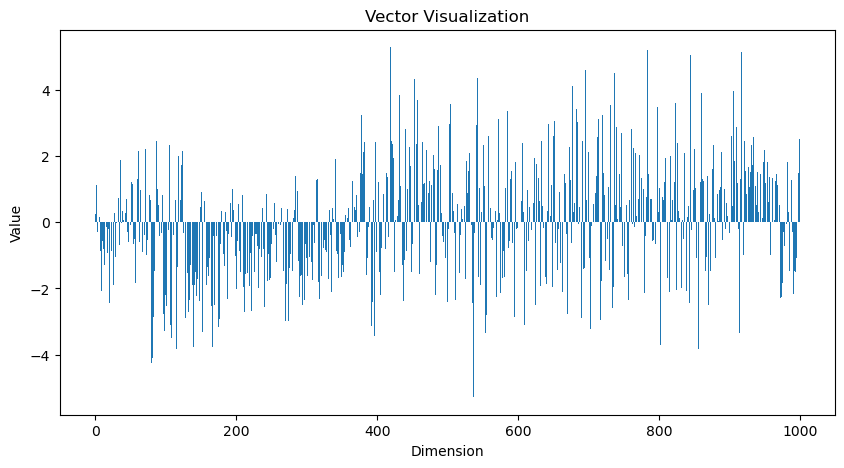

### Color Moments - Euclidean Distance

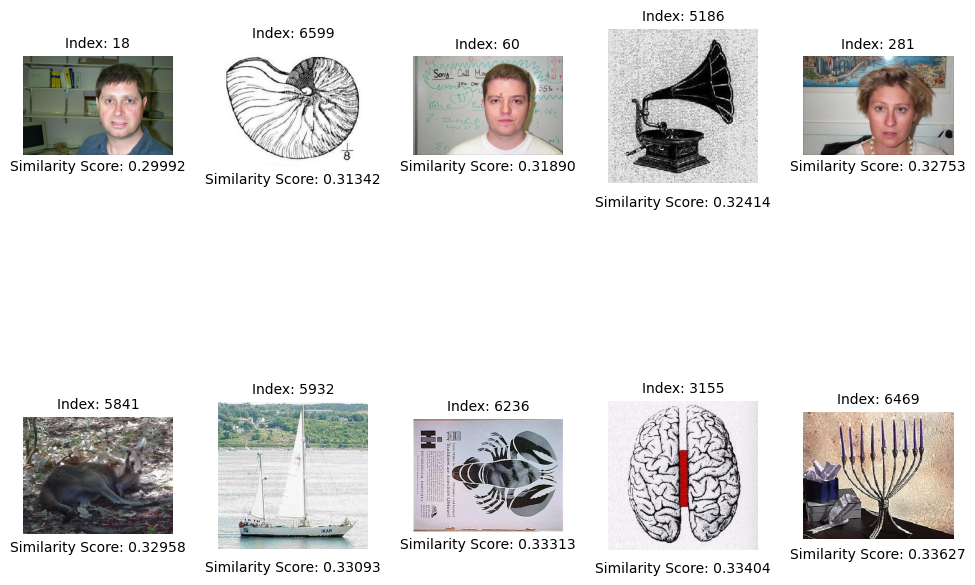

### Histograms of Oriented Gradients(HOG) - Cosine Similarity

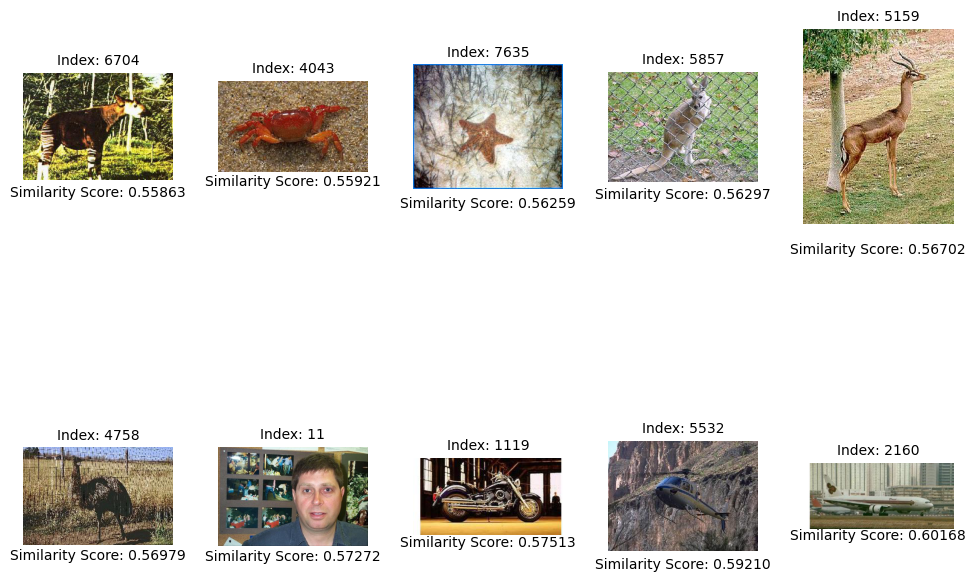

### ResNet-AvgPool-1024 - Cosine Similarity

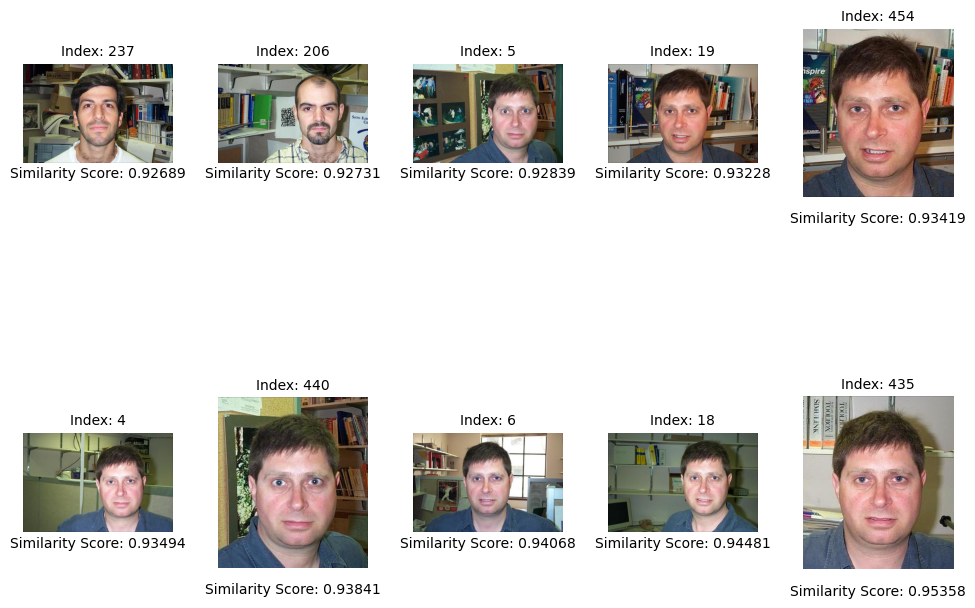

### ResNet-Layer3-1024 - Euclidean Distance

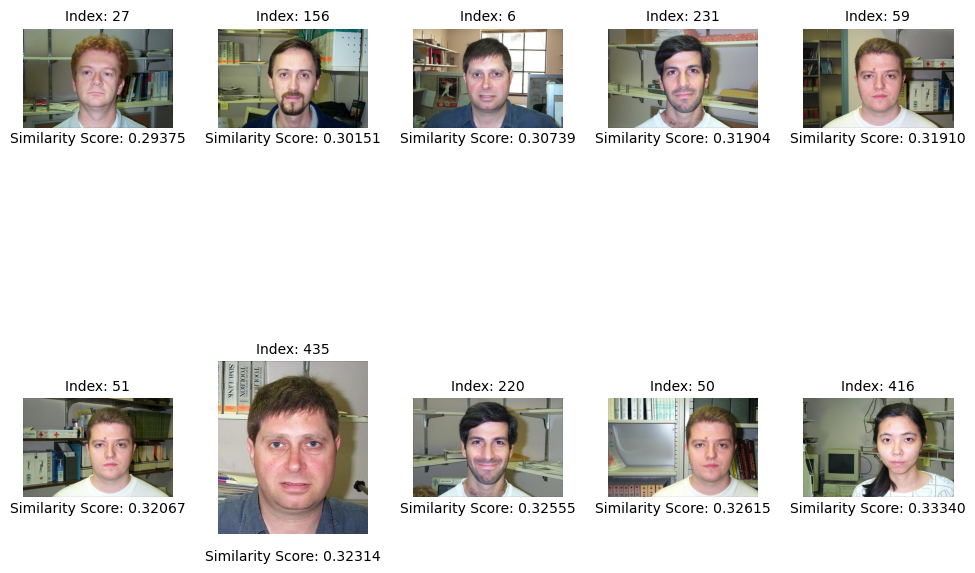

### ResNet-FC-1000 - Cosine Similarity

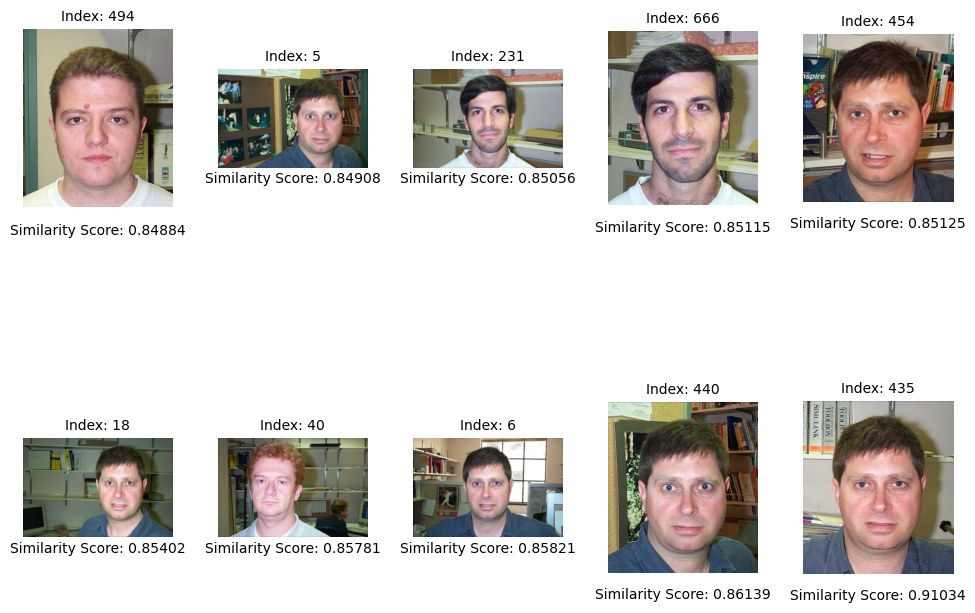

In [67]:
similarity_scores0 = task3(0,10)

  0%|          | 0/8677 [00:00<?, ?it/s]

### Query Image


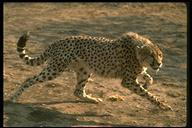

### Query Image Color Moments

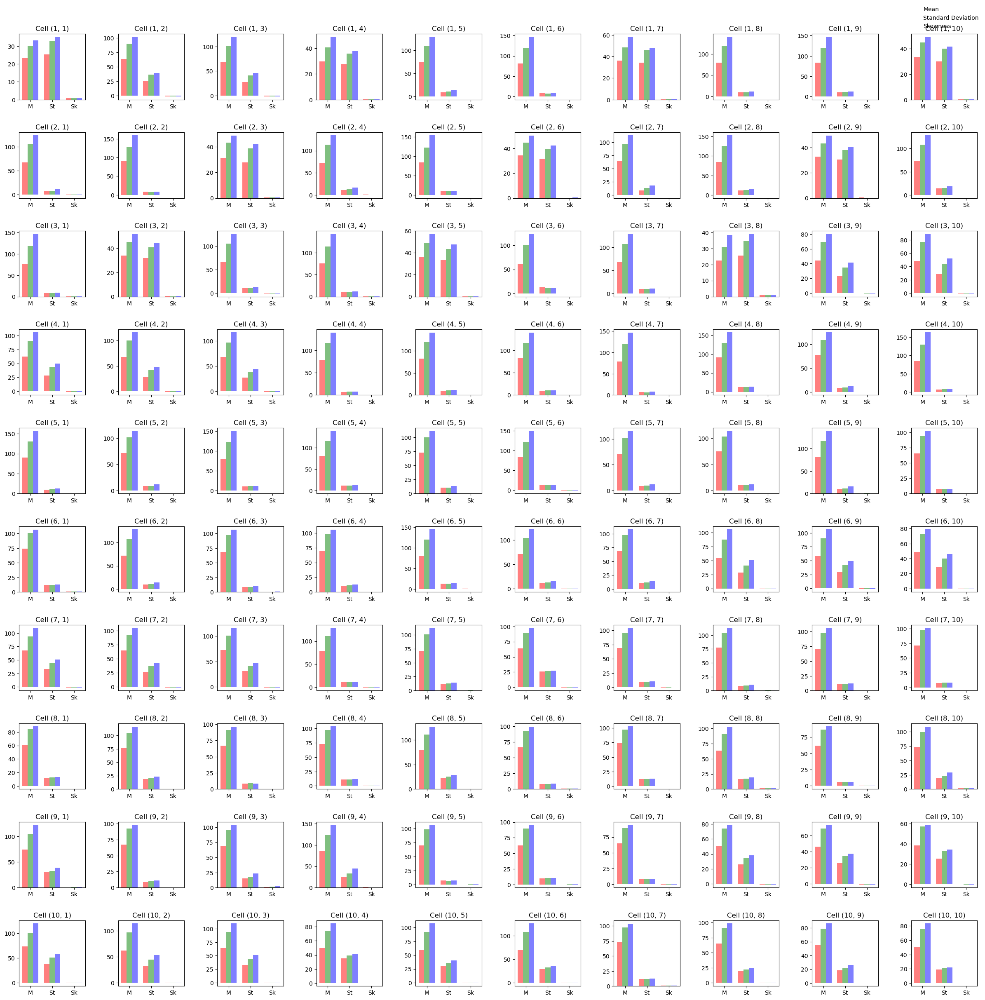

### Query Image HOG Descriptor

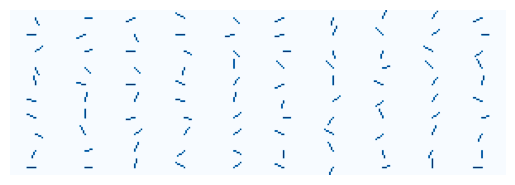

### Query Image Avgpool Descriptor

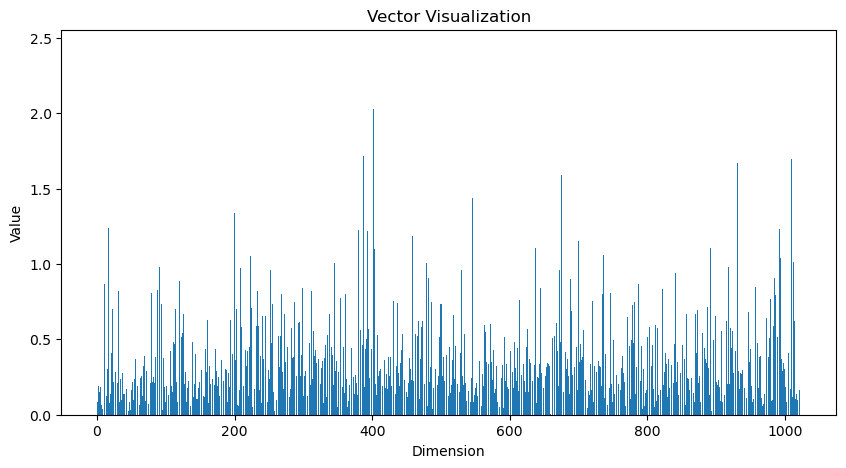

### Query Image Layer3 Descriptor

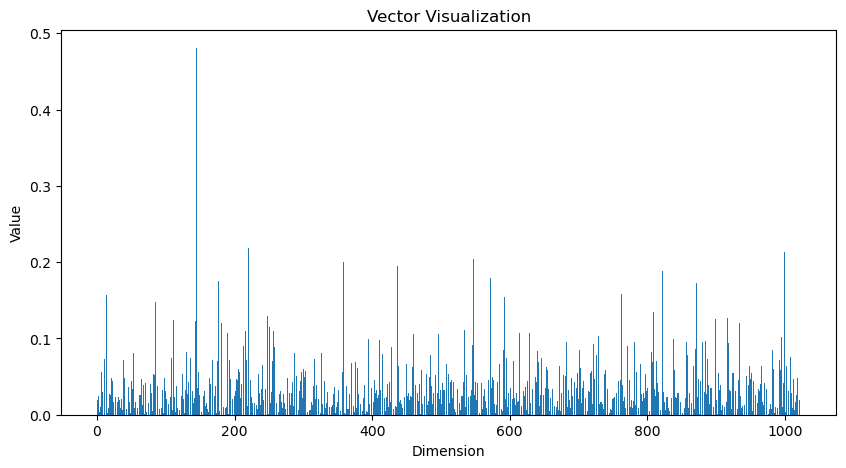

### Query Image FC Descriptor

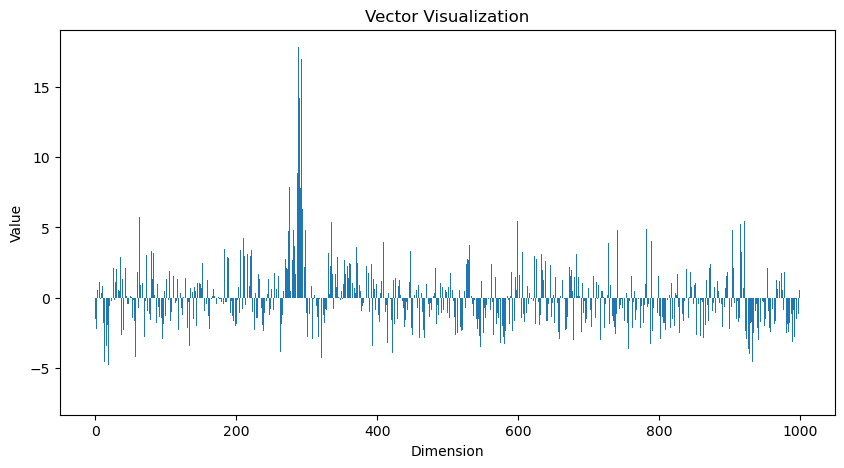

### Color Moments - Euclidean Distance

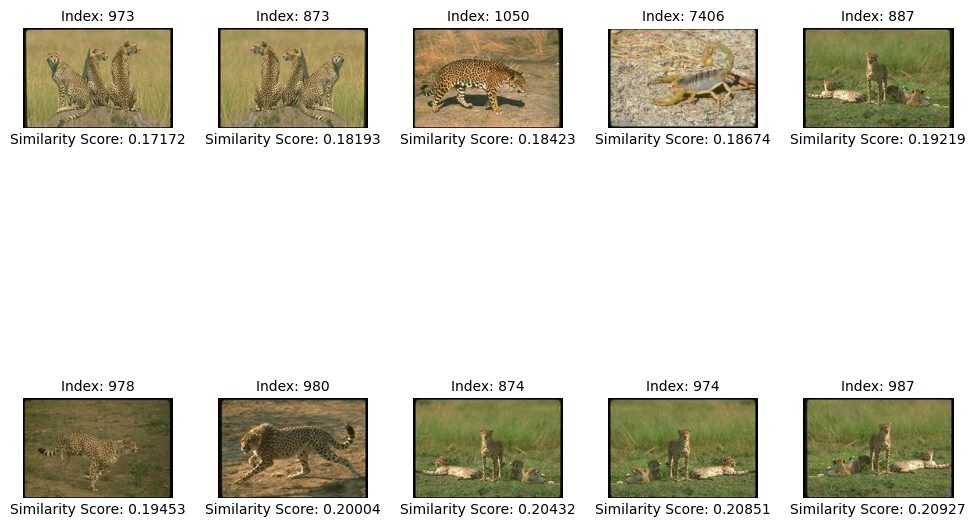

### Histograms of Oriented Gradients(HOG) - Cosine Similarity

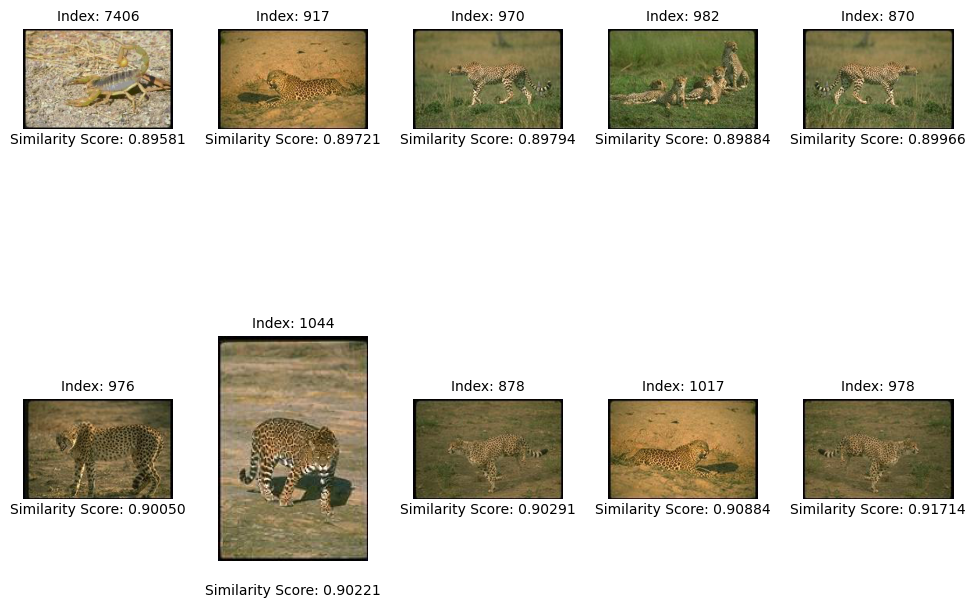

### ResNet-AvgPool-1024 - Cosine Similarity

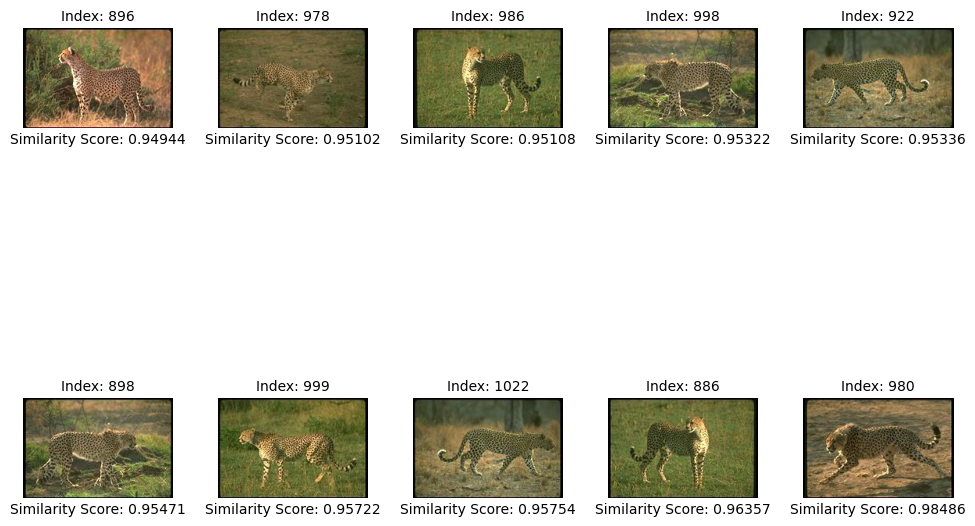

### ResNet-Layer3-1024 - Euclidean Distance

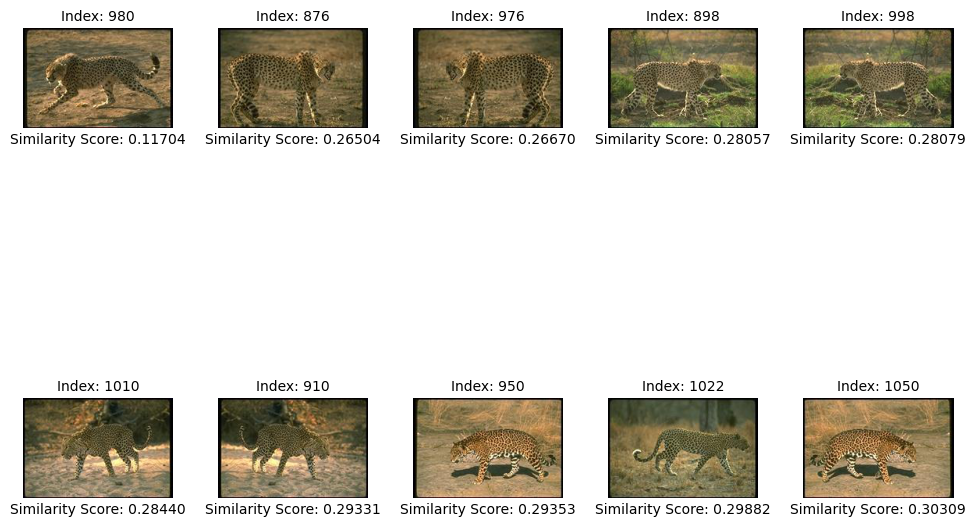

### ResNet-FC-1000 - Cosine Similarity

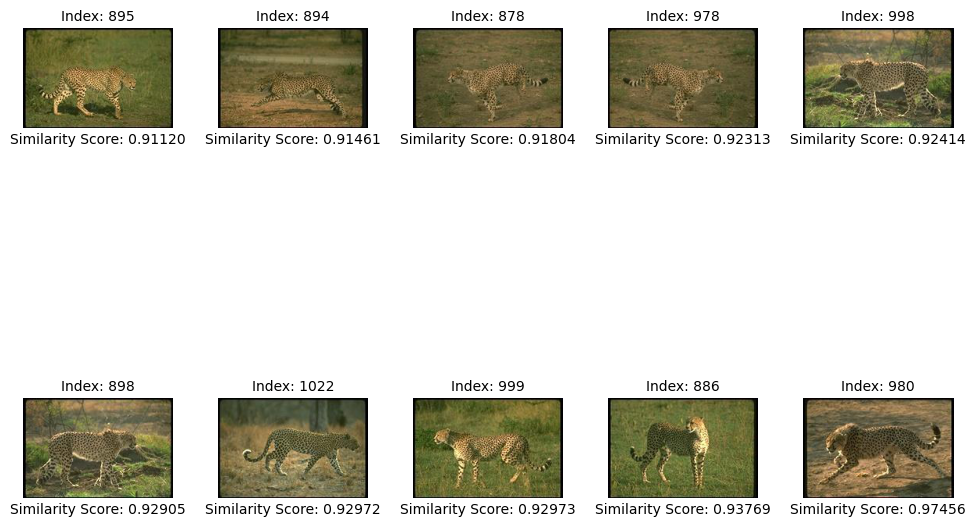

In [68]:
similarity_scores880 = task3(880,10)

  0%|          | 0/8677 [00:00<?, ?it/s]

### Query Image


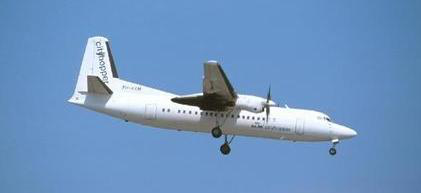

### Query Image Color Moments

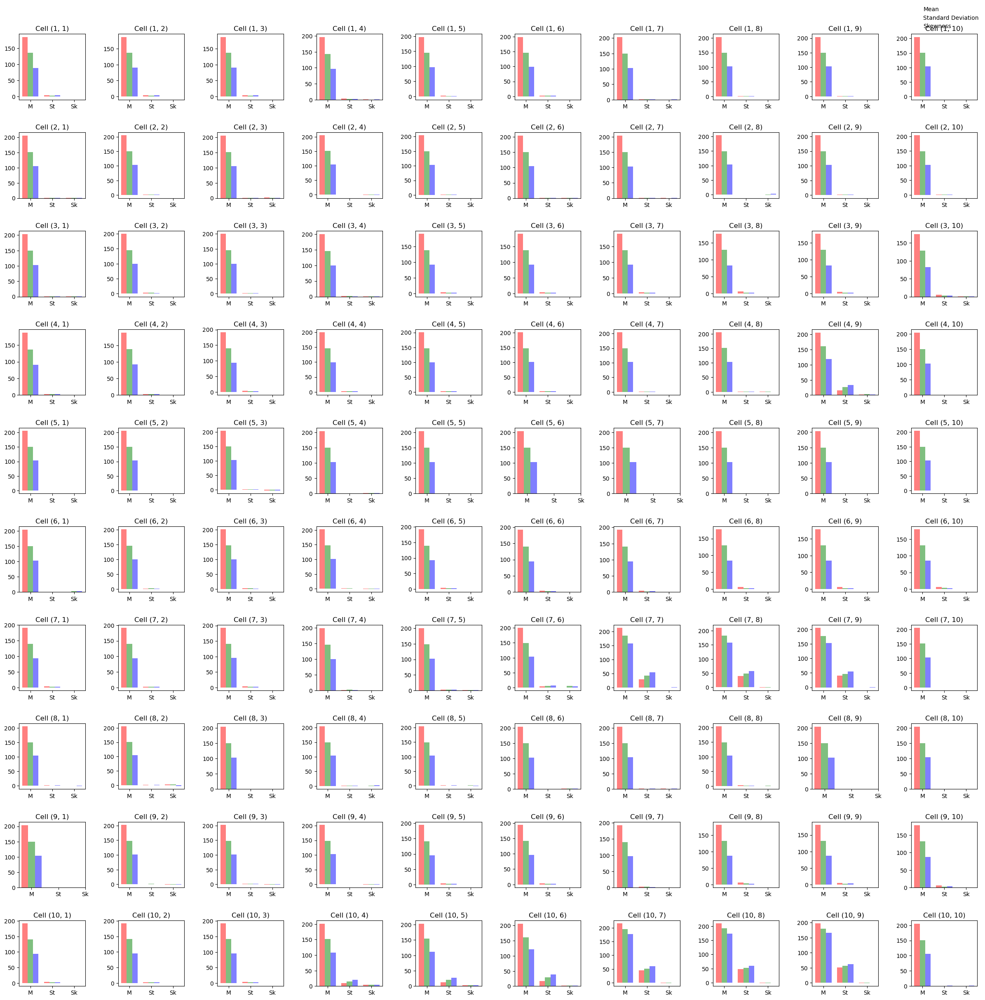

### Query Image HOG Descriptor

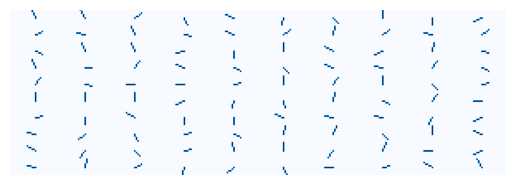

### Query Image Avgpool Descriptor

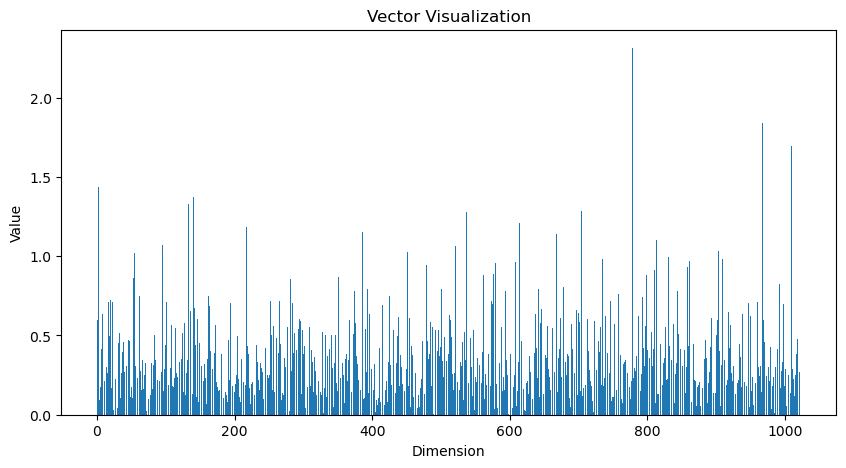

### Query Image Layer3 Descriptor

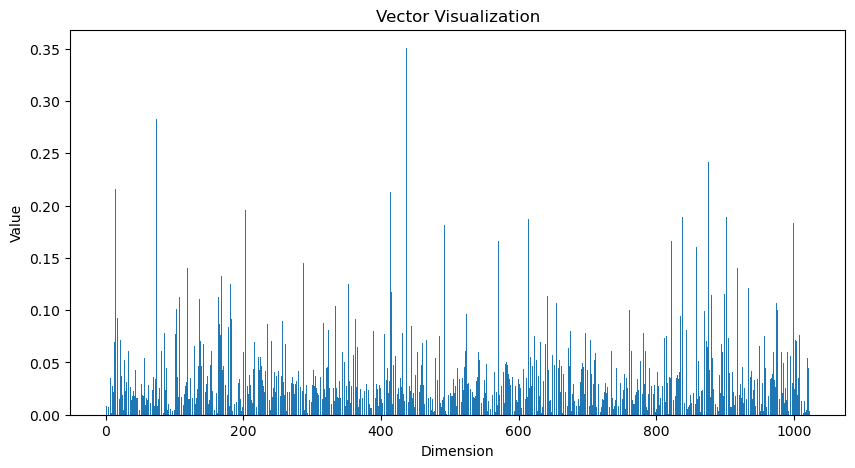

### Query Image FC Descriptor

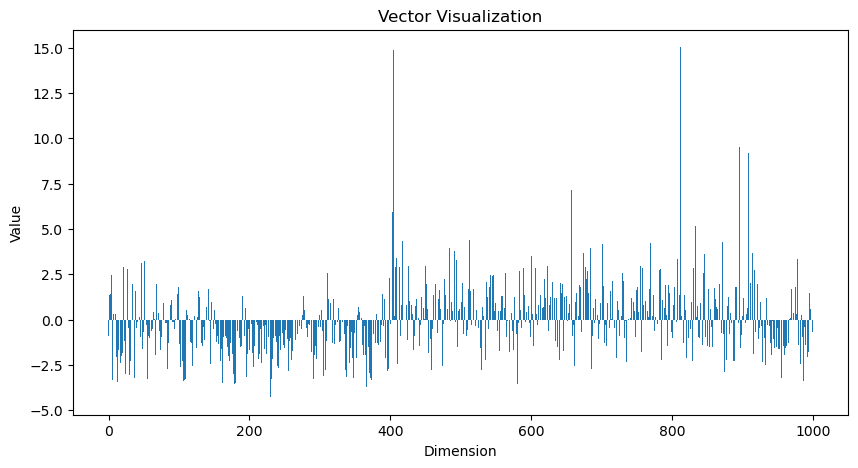

### Color Moments - Euclidean Distance

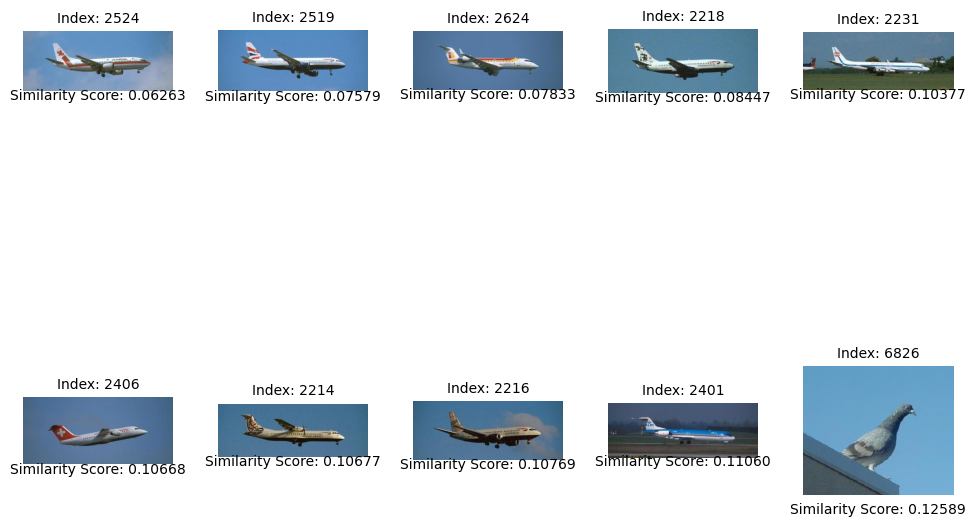

### Histograms of Oriented Gradients(HOG) - Cosine Similarity

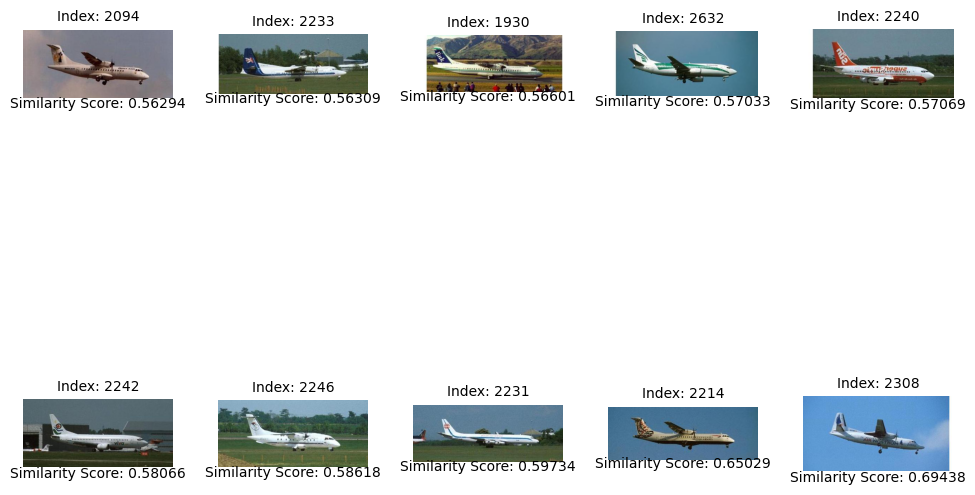

### ResNet-AvgPool-1024 - Cosine Similarity

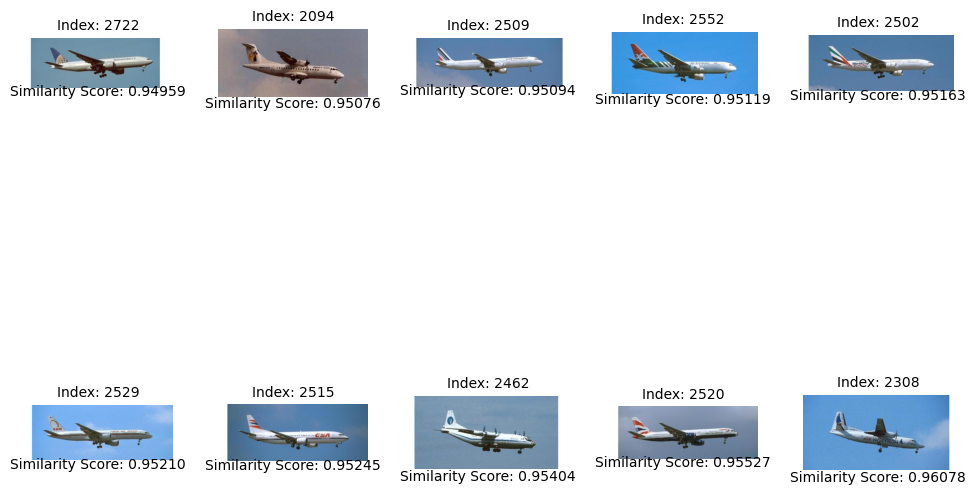

### ResNet-Layer3-1024 - Euclidean Distance

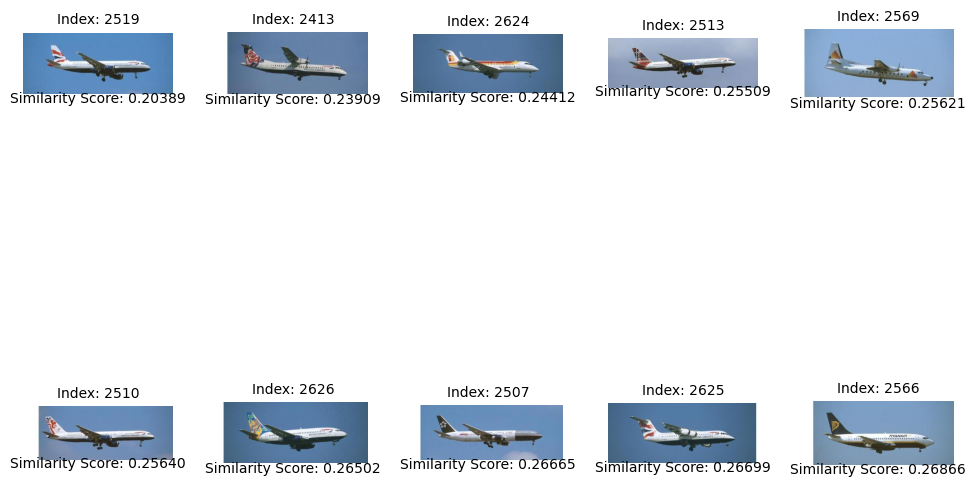

### ResNet-FC-1000 - Cosine Similarity

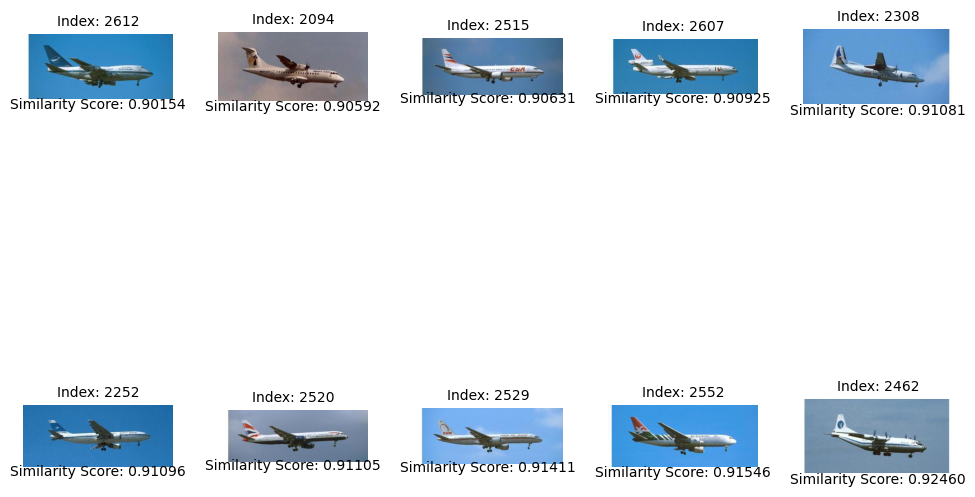

In [69]:
similarity_scores2500 = task3(2500,10)

  0%|          | 0/8677 [00:00<?, ?it/s]

### Query Image


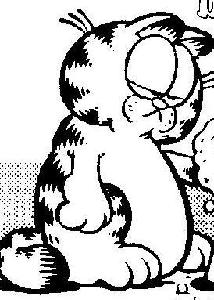

### Query Image Color Moments

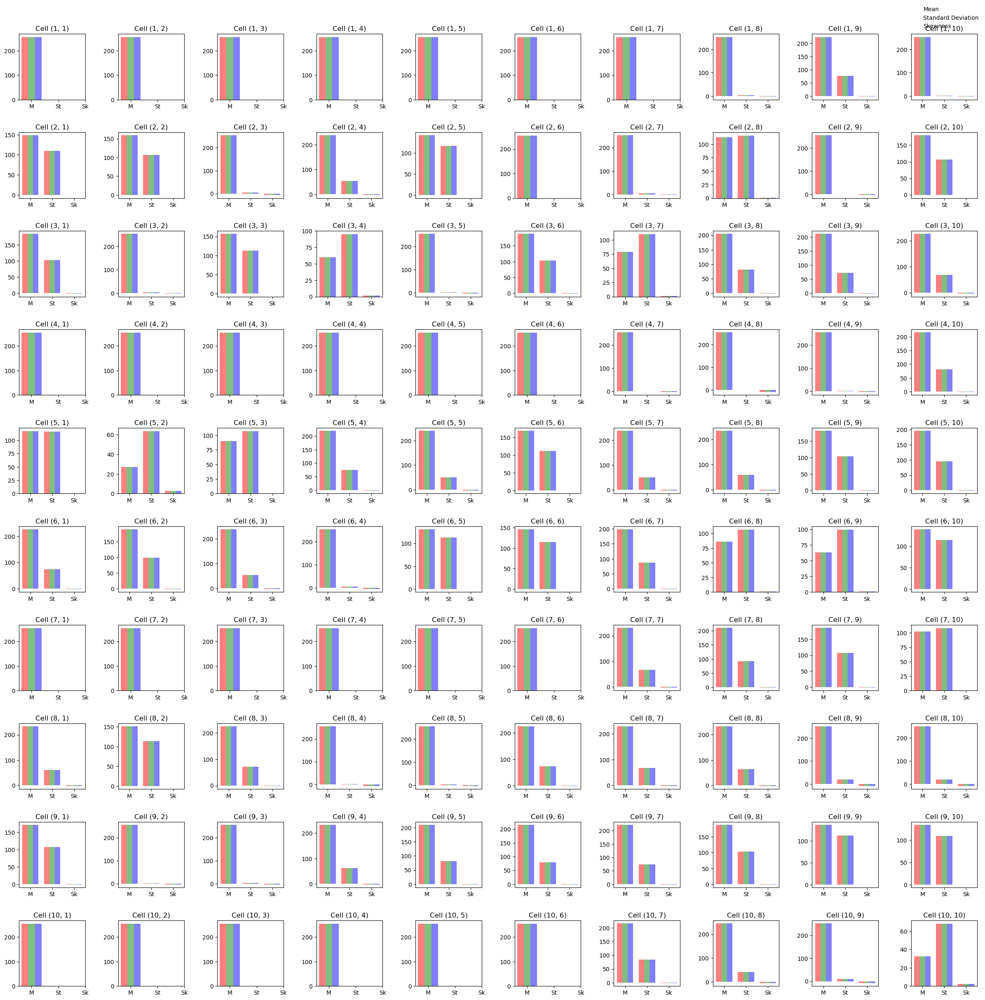

### Query Image HOG Descriptor

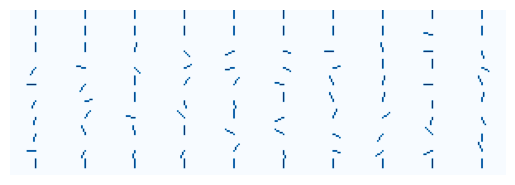

### Query Image Avgpool Descriptor

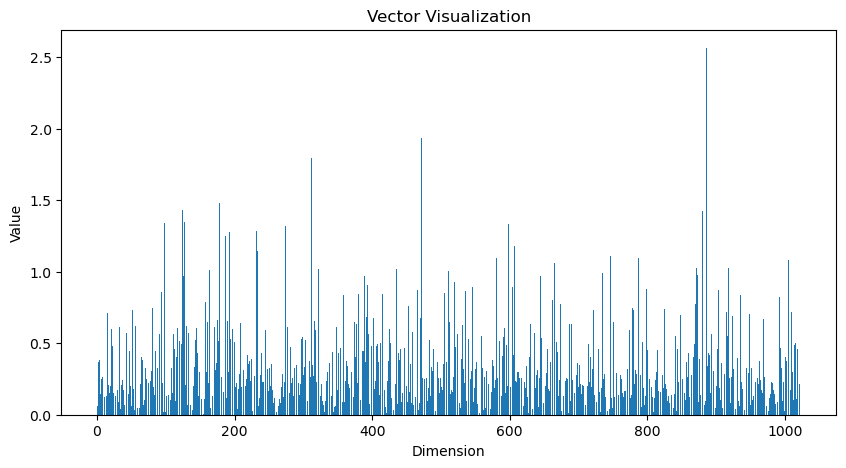

### Query Image Layer3 Descriptor

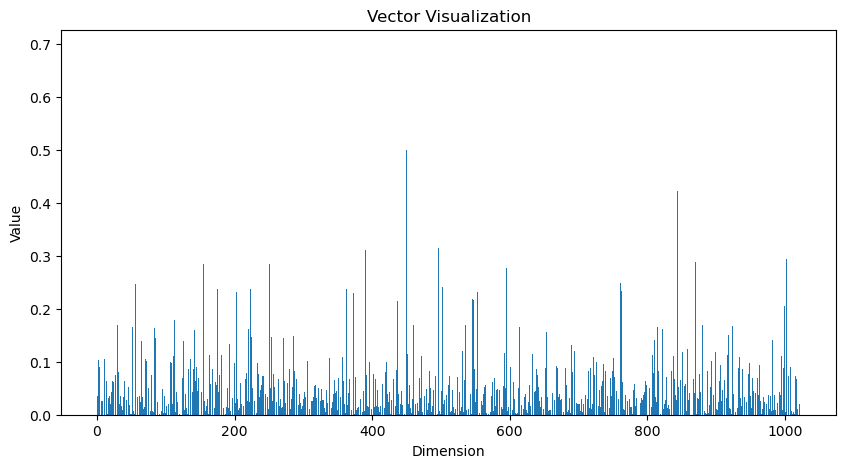

### Query Image FC Descriptor

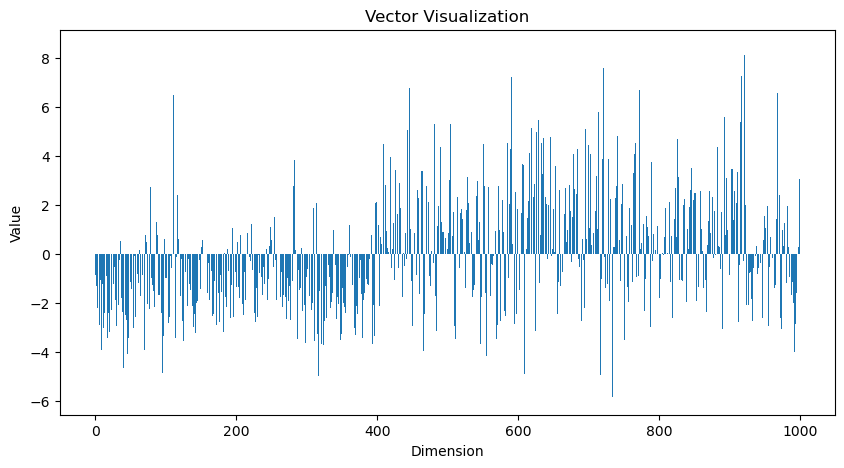

### Color Moments - Euclidean Distance

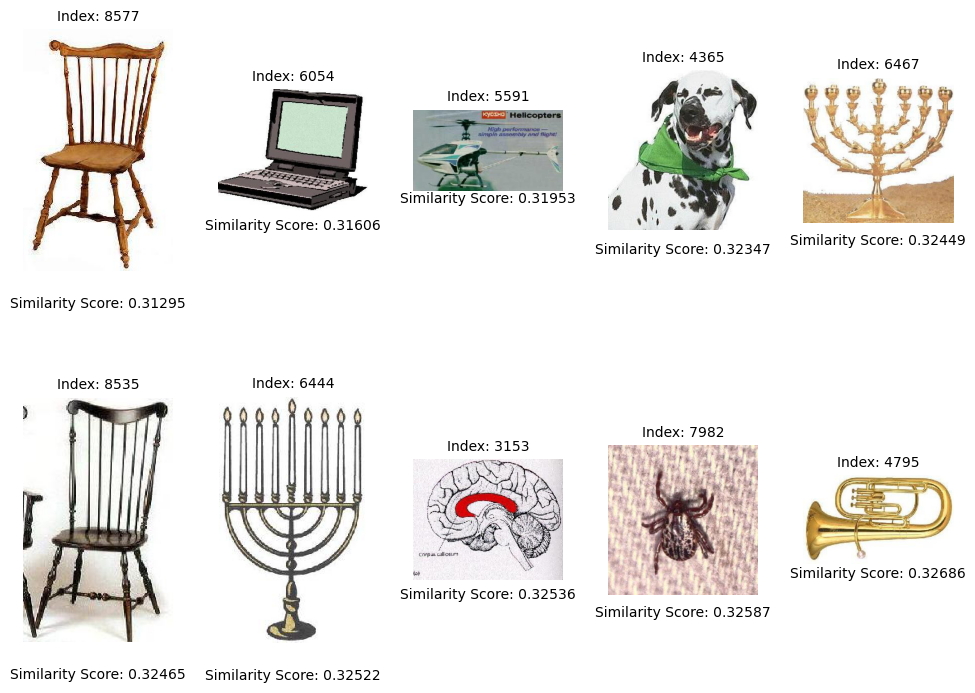

### Histograms of Oriented Gradients(HOG) - Cosine Similarity

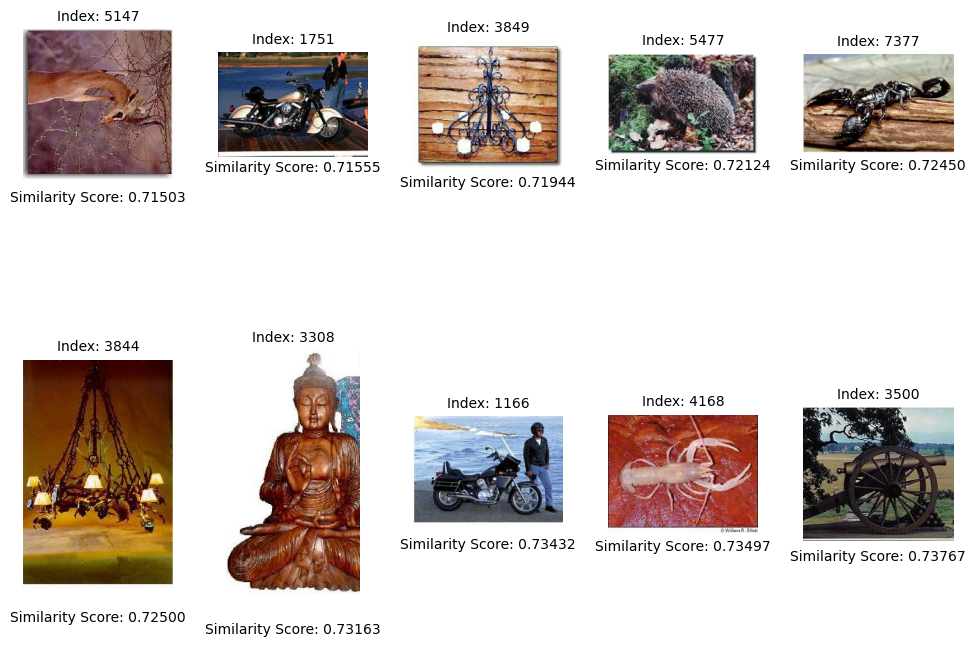

### ResNet-AvgPool-1024 - Cosine Similarity

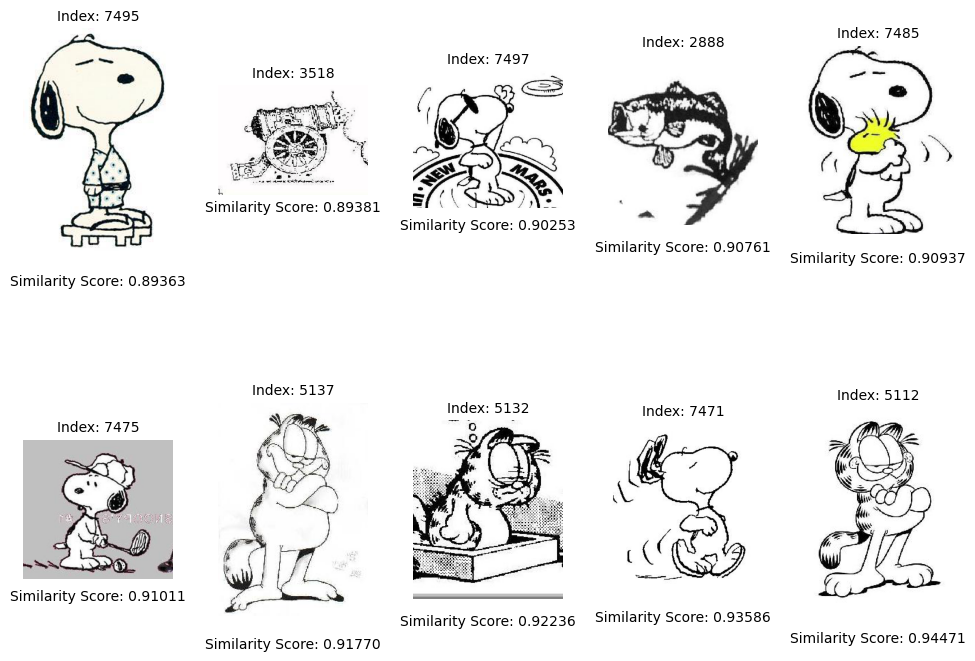

### ResNet-Layer3-1024 - Euclidean Distance

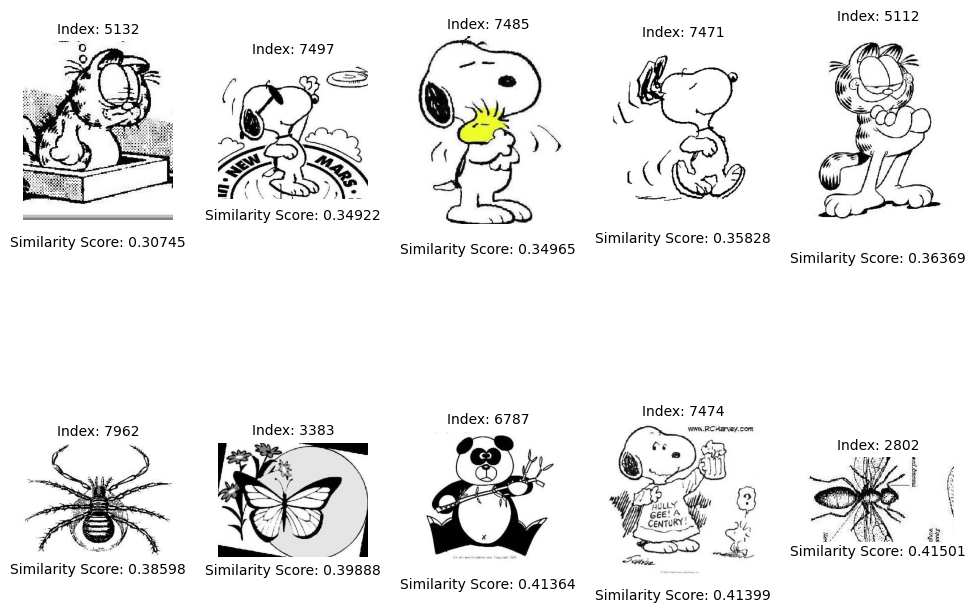

### ResNet-FC-1000 - Cosine Similarity

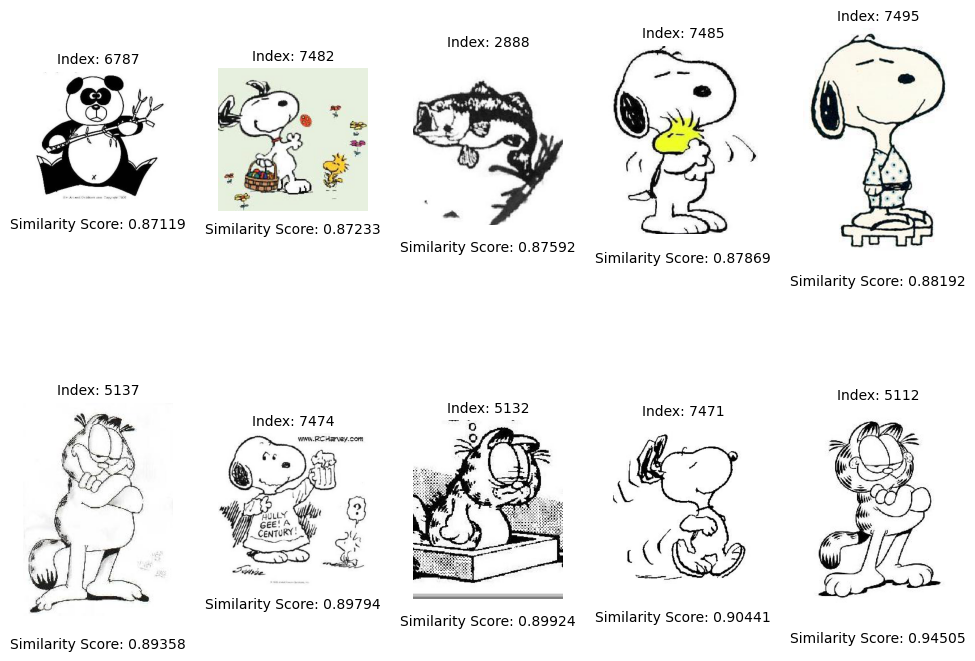

In [70]:
similarity_scores5122 = task3(5122,10)

  0%|          | 0/8677 [00:00<?, ?it/s]

### Query Image


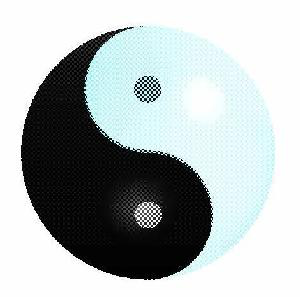

### Query Image Color Moments

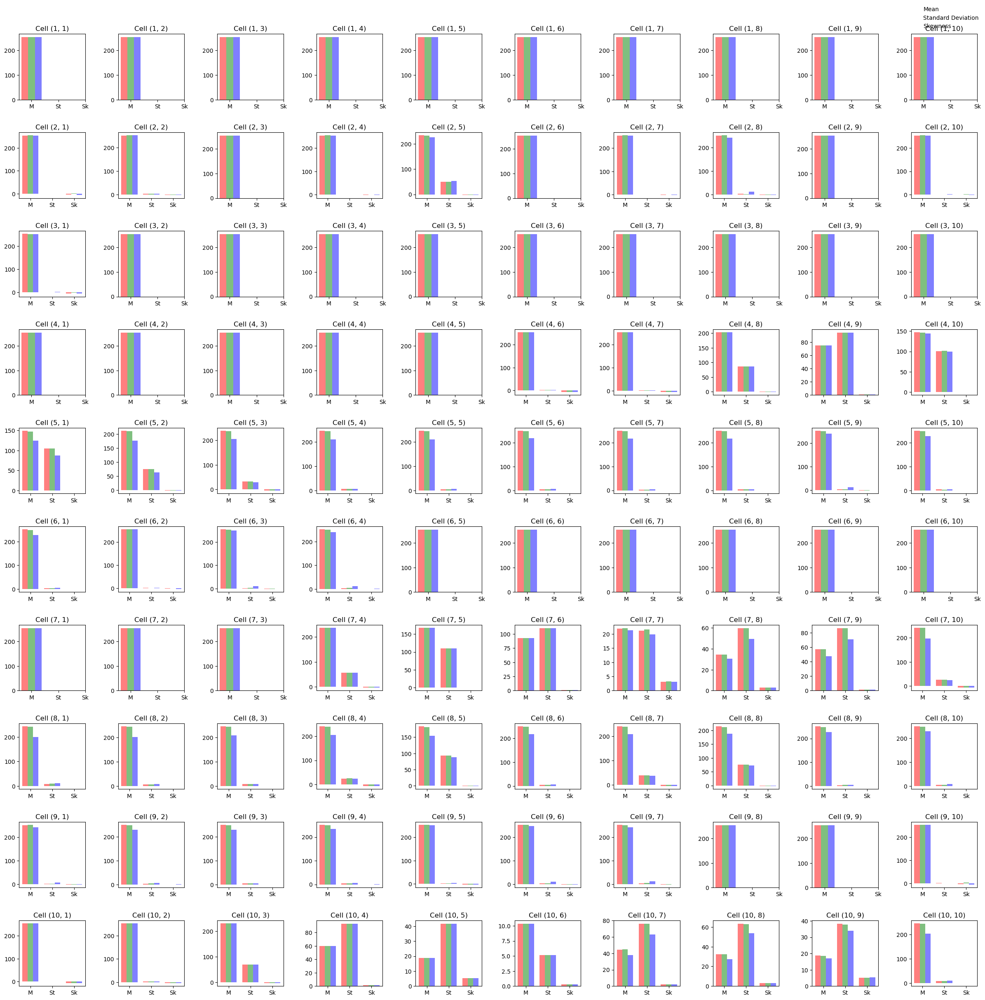

### Query Image HOG Descriptor

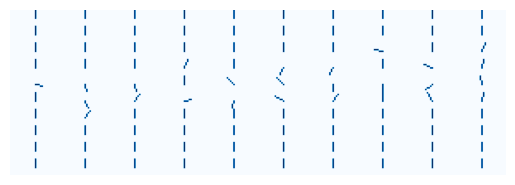

### Query Image Avgpool Descriptor

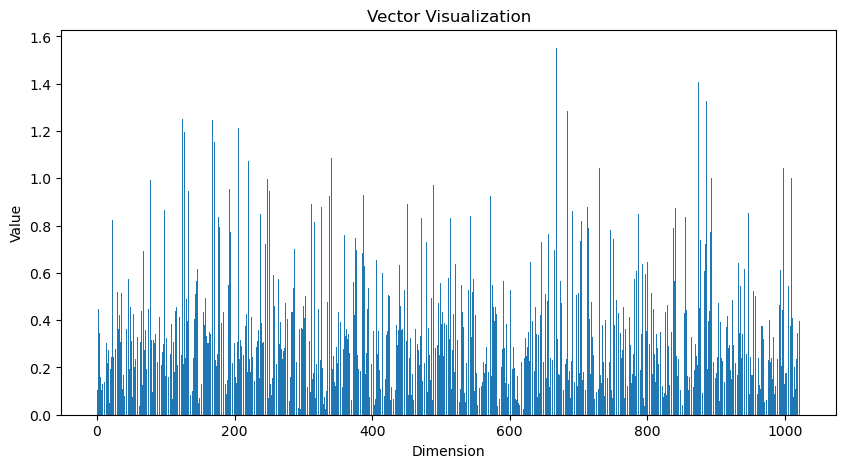

### Query Image Layer3 Descriptor

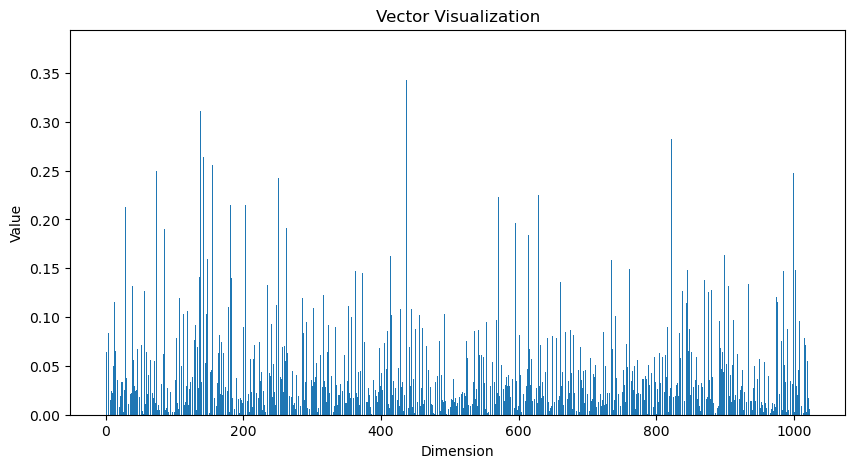

### Query Image FC Descriptor

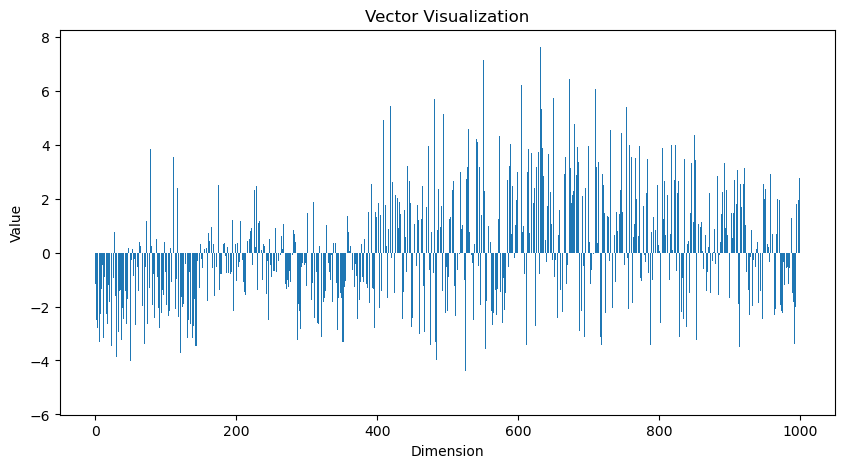

### Color Moments - Euclidean Distance

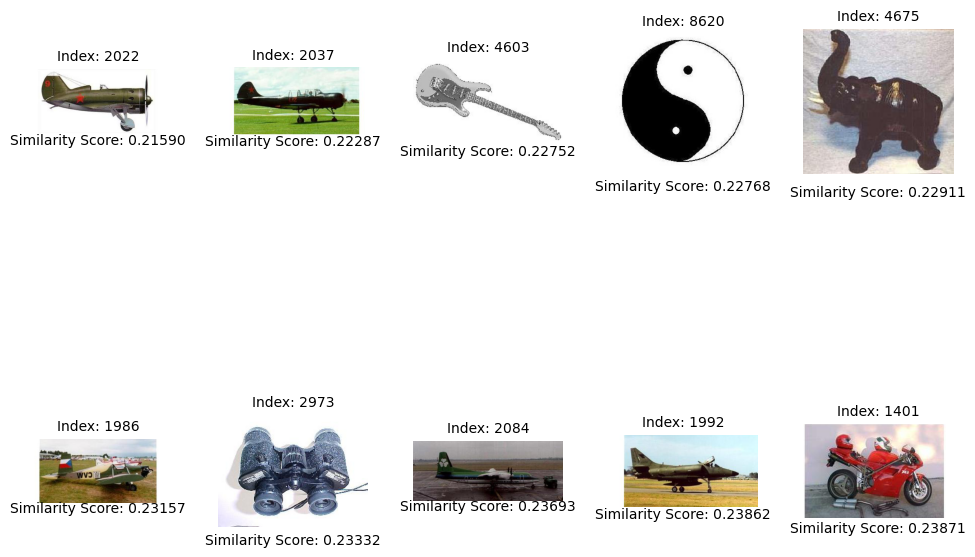

### Histograms of Oriented Gradients(HOG) - Cosine Similarity

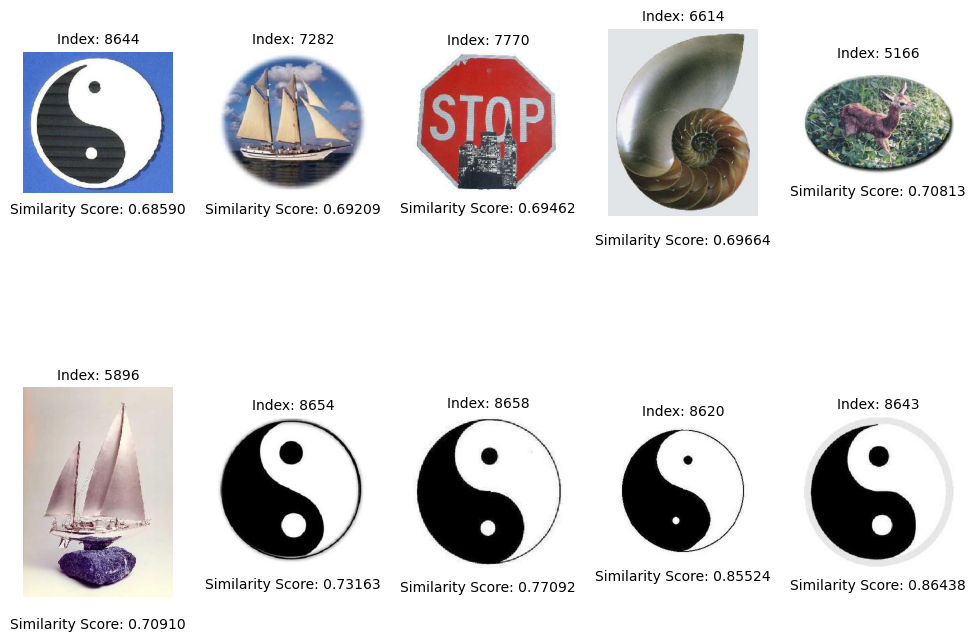

### ResNet-AvgPool-1024 - Cosine Similarity

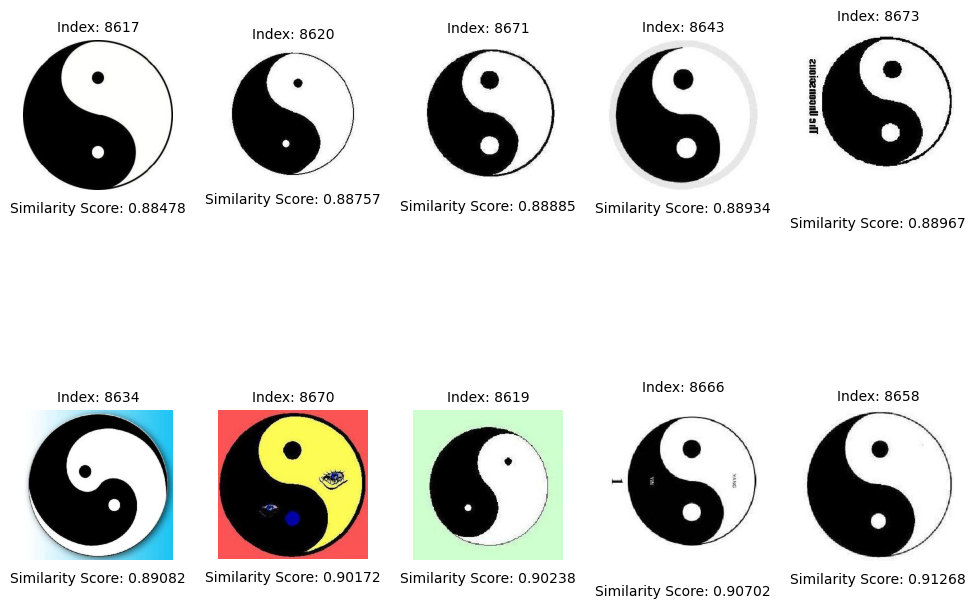

### ResNet-Layer3-1024 - Euclidean Distance

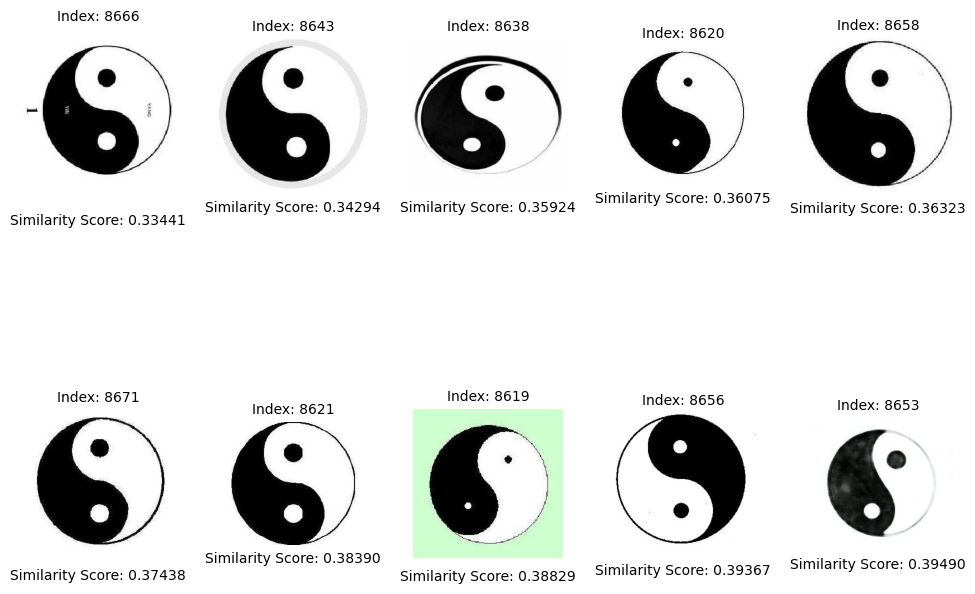

### ResNet-FC-1000 - Cosine Similarity

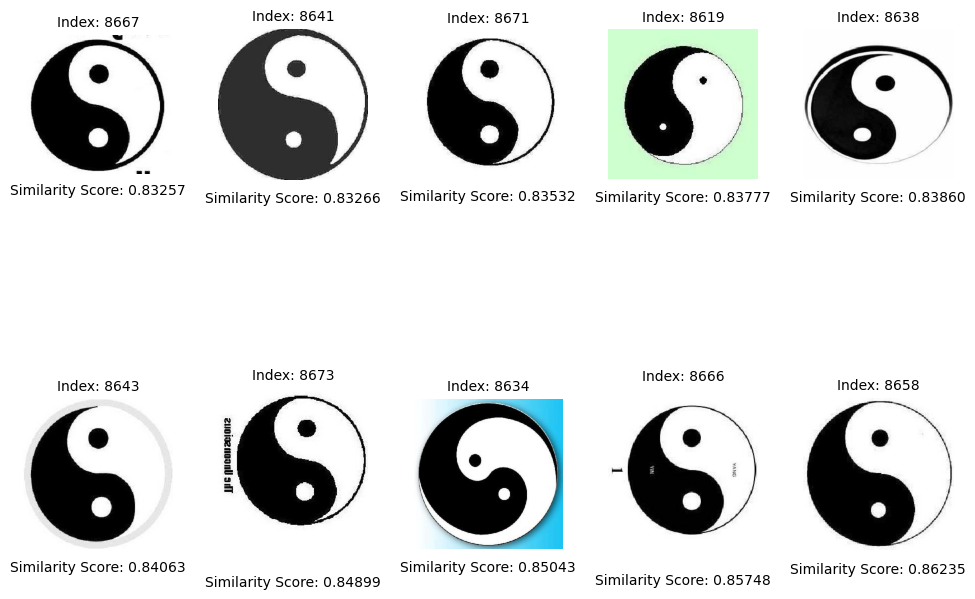

In [71]:
similarity_scores8676 = task3(8676,10)

## Interface for User Input

In [72]:
display(Markdown("## Get k Similar Images - Pass the value as ' ImageId , k '"))
text = widgets.Text(
    value='',
    placeholder=' ImageID , k ',
    description='',
    disabled=False
)
display(text)

def callback(wdgt):
    # replace by something useful
    imageid = int(wdgt.value.split(',')[0].strip())
    k = int(wdgt.value.split(',')[1].strip())
    document = collection.find_one({'_id': imageid})
    np.array(document['image'], dtype=np.uint8)
    display(Markdown("### Query Image"))
    show_image_centered(np.array(image))
    display(Markdown("### Query Image Color Moments"))
    plot_cm(np.array(document['color_moments']))
    display(Markdown("### Query Image HOG Descriptor"))
    vis_hog(document['hog_descriptor'])
    display(Markdown("### Query Image Avgpool Descriptor"))
    vis_vector(document['avgpool_descriptor'])
    display(Markdown("### Query Image Layer3 Descriptor"))
    vis_vector(document['layer3_descriptor'])
    display(Markdown("### Query Image FC Descriptor"))
    vis_vector(document['fc_descriptor'])
    task3(imageid, k)
    clear_output(wait=True)  # Clear the output after processing the input

text.on_submit(callback)

## Get k Similar Images - Pass the value as ' ImageId , k '

Text(value='', placeholder=' ImageID , k ')